### *Objective:*
 - __Build a Machine Learning model to predict the data of payment of an invoice.__

### *Technology And Libraries Used:* 
  - Machine Learning
  - Scikit-Learn
  - Python
  - Numpy
  - Pandas
  - Matplotlib
  - Seaborn
  - Plotly
  - Pickle

### *Problem Statement:*
 - I received an invoice dataset that contains the past payment information and behaviour of various buyers. Based on the previous payment patterns, the ML model needs to predict what will be the date a payment is to be made by the customer for an invoice. The model also needs to predict which aging bucket the invoice falls into based on the predicted payment date. 
 - Basially, the Machine Learning part is divided into two subparts:
     - To build a Machine Learning Model to predict the payment date of an invoice when it gets created in the system. 
     - Categorize the invoice into different buckets based on predicted payment date.
            - 0-15 days 
            - 16-30 days 
            - 31-45 days 
            - 46-60 days 
            - Greater than 60 days

 
 
__The work flow for the project is as follows:__
- [Data Acquisition](#task_1)
- [Data Preprocessing](#task_2)
- [Splitting The Dataset into train and test](#task_3)
- [Feature Engineering](#task_4)
- [Splitting The Dataset into train and validation](#task_5)
- [Model Building](#task_6)
  - [Model Hyperparameter Optimization](#task_7)
  - [Model Selection](#task_8)
  - [Feature Importance](#task_9)
  - [Predictions On Reduced Features](#task_10)
- [Inference on test dataset](#task_11)
- [Final Result](#task_12)


### *Dataset Information:*
  - I received a dataset which contains 50000 rows and 19 features listed below.
 
**Original Features in Dataset:**
   - business_code - company code of the account
   - cust_number - customer number given to all the customers of the Account
   - name_customer - name of the customer.
   - clear_date - The date on which the customer clears an invoice, or in simple terms, they make the full payment.
   - buisness_year - the year in which invoice was created
   - doc_id - It is also an unique identifier of an invoice is a primary key for acct_doc_header table
   - posting_date - 
   - document_create_date - The date on which the document was created
   - document_create_date.1 - The date on which the invoice document was created 
   - due_in_date - The date on which the customer is expected to clear an invoice
   - invoice_currency - The currency of the invoice amount in the document for the invoice
   - document type - It represents the type of document. eg D1 represents Invoice
   - posting_id - key indicator to identify whether an AR item is invoice, deduction, credit memo based on its value. Apllicable for SAP ERP
   - area_business - Business area in sap is defined as an organisationalarea within the financial accounting module.
   - total_open_amount - The amount that is yet to be paid for that invoice
   - baseline_create_date - The date on which the Invoice was created.
   - cust_payment_terms - Business terms and agreements between customers and accounts on discounts and days of payment
   - invoice_id - Unique number assigned when a seller creates an Invoice. 	
   - isOpen - indicator of whether an invoice is open or closed. isopen = 1, means the invoice is open.
   
   
**Engineered Features:**
 - *__Invoice Level Features__*
     - **paid_invoices** - Number of paid invoices prior to the creation date of a new invoice of a customer. 
     - **late_paid_invoices** - Number of invoices which were paid late prior to the creation date of a new invoice of a customer 
     - **ratio_late_paid_invoices** - late_paid_invoices / paid_invoices
     - **total_amount_paid_invoices** - The sum of the base amount from all the paid invoices prior to the creation of new invoice for a customer.
     - **total_amount_late_paid_invoices** - The sum of the base amount from all the paid invoices which were late prior to the creation of new invoice for a customer. 
     - **ratio_amount_late_paid_invoices** - total_amount_late_paid_invoices / total_amount_paid_invoices
     - **average_days_late** - Average days late of all paid invoices that were late prior to the creation date of a new invoice for a customer.
     - **total_outstanding_invoices** - Number of the outstanding invoices prior to the creation date of a new invoice of a customer. 
     - **total_late_outstanding_invoices** - Number of the outstanding invoices which were late prior to the creation date of a new invoice of a customer.
     - **ratio_late_outstanding_invoices** - total_late_outstanding_invoices / total_outstanding_invoices
     - **total_amount_outstanding_invoices** - The sum of the base amount from all the outstanding invoices prior to the creation of new invoice for a customer.
     - **total_amount_late_outstanding_invoices** - The sum of the base amount from all the outstanding invoices which were late prior to the creation of new invoice for a customer. 
     - **ratio_amount_late_outstanding_invoices** - total_amount_late_outstanding_invoices / total_amount_outstanding_invoices
     - **average_days_late_outstanding_invoices** - Average days late of all outstanding invoices that were late prior to the creation of new invoice for a customer.



## Data Acquisition<a id='task_1'></a>

### Import Libraries

In [1]:
#import libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from datetime import datetime
from time import time
from IPython.display import display
import warnings
warnings.filterwarnings('ignore')

In [2]:
#load the dataset
data = pd.read_csv('1804426.csv')
data.head(10)                                 

,business_code,cust_number,name_customer,clear_date,buisness_year,doc_id,posting_date,document_create_date,document_create_date.1,due_in_date,invoice_currency,document type,posting_id,area_business,total_open_amount,baseline_create_date,cust_payment_terms,invoice_id,isOpen
0,U001,0200759878,SA us,2019-02-04 00:00:00,2019.0,1.928651e+09,2019-01-19,20190119,20190119,20190203.0,USD,RV,1.0,NaN,33876.74,20190119.0,NAH4,1.928651e+09,0
1,U001,0200792734,MDV/ us,2019-10-03 00:00:00,2019.0,1.929891e+09,2019-09-18,20190918,20190918,20191003.0,USD,RV,1.0,NaN,9085.62,20190918.0,NAA8,1.929891e+09,0
2,U001,0200769623,WAL-MAR corp,2019-12-24 00:00:00,2019.0,1.930228e+09,2019-12-12,20191206,20191212,20191227.0,USD,RV,1.0,NaN,1077.54,20191212.0,NAH4,1.930228e+09,0
3,U001,0200764795,SYSCO systems,2019-04-16 00:00:00,2019.0,1.929062e+09,2019-04-02,20190331,20190402,20190417.0,USD,RV,1.0,NaN,291.64,20190402.0,NAA8,1.929062e+09,0
4,U001,0200331749,SYSC,2020-03-09 00:00:00,2020.0,1.930463e+09,2020-02-05,20200201,20200205,20200308.0,USD,RV,1.0,NaN,15717.74,20200205.0,NA32,1.930463e+09,0
5,U001,0200875006,KROGER llc,2019-03-15 00:00:00,2019.0,1.928878e+09,2019-02-28,20190228,20190228,20190315.0,USD,RV,1.0,NaN,47093.22,20190228.0,NAA8,1.928878e+09,0
6,U001,200721222,GO systems,2019-03-26 00:00:00,2019.0,1.928944e+09,2019-03-11,20190311,20190311,20190326.0,USD,RV,1.0,NaN,47477.54,20190311.0,NAA8,1.928944e+09,0
7,U001,0200529372,GHC in,2019-12-02 00:00:00,2019.0,1.930154e+09,2019-11-15,20191114,20191115,20191130.0,USD,RV,1.0,NaN,10916.57,20191115.0,NAA8,1.930154e+09,0
8,U001,0200609331,KROG associates,2019-10-30 00:00:00,2019.0,1.930015e+09,2019-10-15,20191015,20191015,20191030.0,USD,RV,1.0,NaN,42667.13,20191015.0,NAA8,1.930015e+09,0
9,CA02,0100008347,E D S us,2019-09-06 00:00:00,2019.0,2.960557e+09,2019-06-28,20190628,20190628,20190731.0,CAD,RV,1.0,NaN,13535.12,20190701.0,CA30,2.960557e+09,0


In [3]:
data.shape# shape of the dataset(nos of rows and columns)

(50000, 19)

### Data Preprocessing<a id='task_2'></a>

In [4]:
#print all the columns of the dataset
data.columns

Index(['business_code', 'cust_number', 'name_customer', 'clear_date',
       'buisness_year', 'doc_id', 'posting_date', 'document_create_date',
       'document_create_date.1', 'due_in_date', 'invoice_currency',
       'document type', 'posting_id', 'area_business', 'total_open_amount',
       'baseline_create_date', 'cust_payment_terms', 'invoice_id', 'isOpen'],
      dtype='object')

In [5]:
#change the column names
data.columns = ['business_code', 'customer_number', 'customer_name', 'clear_date', 'business_year',
               'document_id', 'posting_date', 'document_create_date', 'invoice_doc_create_date', 'due_date',
               'invoice_currency', 'document_type', 'posting_id', 'business_area', 'total_open_amount',
               'baseline_create_date', 'customer_payment_terms', 'invoice_id', 'isOpen']

In [6]:
#get the info(non-null values and data type) of all the columns of the dataset
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   business_code            50000 non-null  object 
 1   customer_number          50000 non-null  object 
 2   customer_name            50000 non-null  object 
 3   clear_date               46334 non-null  object 
 4   business_year            50000 non-null  float64
 5   document_id              50000 non-null  float64
 6   posting_date             50000 non-null  object 
 7   document_create_date     50000 non-null  int64  
 8   invoice_doc_create_date  50000 non-null  int64  
 9   due_date                 50000 non-null  float64
 10  invoice_currency         50000 non-null  object 
 11  document_type            50000 non-null  object 
 12  posting_id               50000 non-null  float64
 13  business_area            0 non-null      float64
 14  total_open_amount     

In [7]:
#describes the feature of all the numerical columns of the dataset
data.describe()

,business_year,document_id,document_create_date,invoice_doc_create_date,due_date,posting_id,business_area,total_open_amount,baseline_create_date,invoice_id,isOpen
count,50000.00000,5.000000e+04,5.000000e+04,5.000000e+04,5.000000e+04,50000.0,0.0,50000.000000,5.000000e+04,4.999300e+04,50000.000000
mean,2019.19476,2.013709e+09,2.019241e+07,2.019244e+07,2.019260e+07,1.0,NaN,31993.843412,2.019244e+07,2.012661e+09,0.073320
std,0.39602,2.924282e+08,3.832140e+03,3.826928e+03,3.840146e+03,0.0,NaN,39229.695527,3.828596e+03,2.787071e+08,0.260664
min,2019.00000,1.928505e+09,2.018123e+07,2.018123e+07,2.018080e+07,1.0,NaN,2.160000,2.018072e+07,1.928505e+09,0.000000
25%,2019.00000,1.929231e+09,2.019042e+07,2.019042e+07,2.019051e+07,1.0,NaN,4721.907500,2.019042e+07,1.929230e+09,0.000000
50%,2019.00000,1.929802e+09,2.019080e+07,2.019080e+07,2.019082e+07,1.0,NaN,17226.800000,2.019080e+07,1.929802e+09,0.000000
75%,2019.00000,1.930386e+09,2.019112e+07,2.019112e+07,2.019121e+07,1.0,NaN,46452.270000,2.019112e+07,1.930385e+09,0.000000
max,2020.00000,9.500000e+09,2.020052e+07,2.020052e+07,2.020071e+07,1.0,NaN,682483.430000,2.020052e+07,2.960634e+09,1.000000


In [8]:
#to get a brief analysis of the dataset in html format
import pandas_profiling
data.profile_report(title="HRC Data")

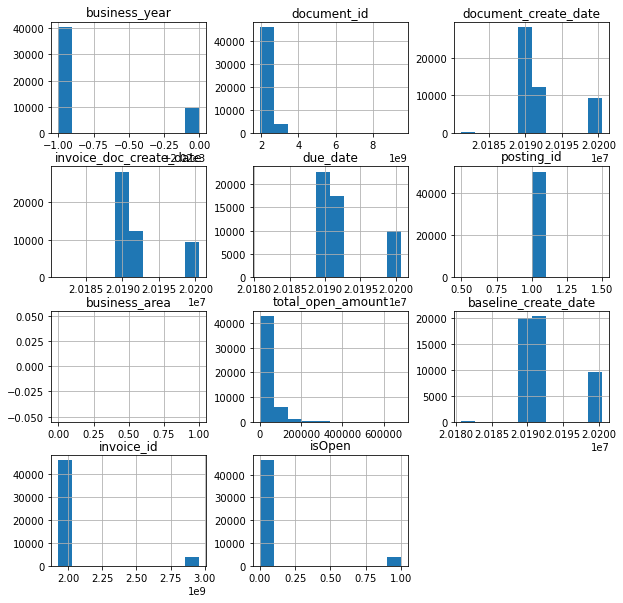

In [9]:
#to check the distribution of all numerical columns                  
data.hist(figsize = (10,10))
plt.show()

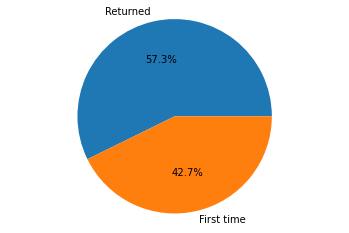

In [10]:
#pie chart visualization of the returned customers and the first time costumers

label = ['Returned' , 'First time'] #setting label names

#storing sum of returned and first time costumers
sizes = [sum(data.customer_name.value_counts() > 1) , sum(data.customer_name.value_counts() == 1)] 
plt.pie(sizes, labels=label , autopct = "%.1f%%")# plotting the pie chart ie mentioning all necessary details
plt.axis('equal')#set equal scaling
plt.show()#display the figure

### Checking for Missing Values

In [11]:
data.isnull().sum() #checking for count of missing values in the dataset

business_code                  0
customer_number                0
customer_name                  0
clear_date                  3666
business_year                  0
document_id                    0
posting_date                   0
document_create_date           0
invoice_doc_create_date        0
due_date                       0
invoice_currency               0
document_type                  0
posting_id                     0
business_area              50000
total_open_amount              0
baseline_create_date           0
customer_payment_terms         0
invoice_id                     7
isOpen                         0
dtype: int64

In [12]:
data[data.clear_date.isnull()] #part of the clear date having null values

,business_code,customer_number,customer_name,clear_date,business_year,document_id,posting_date,document_create_date,invoice_doc_create_date,due_date,invoice_currency,document_type,posting_id,business_area,total_open_amount,baseline_create_date,customer_payment_terms,invoice_id,isOpen
46334,U001,0200794332,COST associates,NaN,2020.0,1.930703e+09,2020-03-25,20200325,20200325,20200409.0,USD,RV,1.0,NaN,11722.55,20200325.0,NAAX,1.930703e+09,1
46335,U001,0200771157,WEIS llc,NaN,2020.0,1.930624e+09,2020-03-09,20200309,20200309,20200324.0,USD,RV,1.0,NaN,125822.66,20200309.0,NAA8,1.930624e+09,1
46336,U001,0200711029,WEGMAN co,NaN,2020.0,1.930687e+09,2020-03-22,20200323,20200322,20200406.0,USD,RV,1.0,NaN,30968.80,20200322.0,NAA8,1.930687e+09,1
46337,U001,0200769623,WAL-MAR corporation,NaN,2020.0,1.930704e+09,2020-03-26,20200325,20200326,20200410.0,USD,RV,1.0,NaN,1329.23,20200326.0,NAH4,1.930704e+09,1
46338,U001,0200704858,WAKE us,NaN,2020.0,1.930672e+09,2020-03-20,20200319,20200320,20200404.0,USD,RV,1.0,NaN,72410.05,20200320.0,NAA8,1.930672e+09,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,U001,0200707741,SMART & llc,NaN,2020.0,1.930774e+09,2020-04-09,20200410,20200409,20200424.0,USD,RV,1.0,NaN,19341.50,20200409.0,NAA8,1.930774e+09,1
49996,U001,0200769623,WAL-MAR co,NaN,2020.0,1.930629e+09,2020-03-11,20200310,20200311,20200326.0,USD,RV,1.0,NaN,49566.80,20200311.0,NAH4,1.930629e+09,1
49997,U001,0200769623,WAL-MAR corp,NaN,2020.0,1.930660e+09,2020-03-18,20200317,20200318,20200402.0,USD,RV,1.0,NaN,5623.01,20200318.0,NAH4,1.930660e+09,1
49998,U001,0200769623,WAL-MAR corp,NaN,2020.0,1.930757e+09,2020-04-07,20200407,20200407,20200422.0,USD,RV,1.0,NaN,12769.59,20200407.0,NAH4,1.930757e+09,1


In [13]:
(data[data.clear_date.isnull()].isOpen == 1).sum() #to check whether all null values have open invoices

3666

In [14]:
sum(data.isOpen==1) # checking, if only those values in clear dates are missing whose invoices are still open ie not paid

3666

In [15]:
data[data.clear_date.isnull()].business_year.value_counts() #all of the invoices of 2020 are unpaid

2020.0    3666
Name: business_year, dtype: int64

In [16]:
data[data.invoice_id.isnull()]#null values in invoice id column

,business_code,customer_number,customer_name,clear_date,business_year,document_id,posting_date,document_create_date,invoice_doc_create_date,due_date,invoice_currency,document_type,posting_id,business_area,total_open_amount,baseline_create_date,customer_payment_terms,invoice_id,isOpen
148,CA02,0100054349,PURITY L foundation,2019-05-31 00:00:00,2019.0,9.500000e+09,2019-03-29,20190329,20190311,20190321.0,CAD,X2,1.0,NaN,3590.82,20190311.0,CA10,NaN,0
8960,CA02,0140104409,LOB systems,2019-12-27 00:00:00,2019.0,9.500000e+09,2019-03-29,20190329,20181228,20190107.0,CAD,X2,1.0,NaN,539.64,20181228.0,CA10,NaN,0
19175,CA02,0140104409,LOB associates,2019-12-27 00:00:00,2019.0,9.500000e+09,2019-03-29,20190329,20190319,20190329.0,CAD,X2,1.0,NaN,179.20,20190319.0,CA10,NaN,0
21078,CA02,0140104429,COSTCO,2019-05-02 00:00:00,2019.0,9.500000e+09,2019-03-29,20190329,20190227,20190309.0,CAD,X2,1.0,NaN,52992.00,20190227.0,CA10,NaN,0
27287,CA02,0100030194,AMAZO,2019-12-27 00:00:00,2019.0,9.500000e+09,2019-03-29,20190329,20190305,20190315.0,CAD,X2,1.0,NaN,313.15,20190305.0,CA10,NaN,0
28783,CA02,0140106054,TREE in,2019-12-27 00:00:00,2019.0,9.500000e+09,2019-03-29,20190329,20190328,20190407.0,CAD,X2,1.0,NaN,216.80,20190328.0,CA10,NaN,0
29612,CA02,0140104409,LOB co,2019-05-08 00:00:00,2019.0,9.500000e+09,2019-03-29,20190329,20190220,20190302.0,CAD,X2,1.0,NaN,14172.84,20190220.0,CA10,NaN,0


In [17]:
data.document_type.value_counts() #no of samples(X2) in the dataset

RV    49993
X2        7
Name: document_type, dtype: int64

In [18]:
#all the null values have doc type X2 ie is a sample invoice, therefore dropping them
data.dropna(subset=['invoice_id'] , inplace = True)

In [19]:
data.invoice_id.isnull().sum()#checking sum of null values

0

### Date Parsing

In [20]:
data.clear_date = data.clear_date.apply(lambda x: pd.to_datetime(x))# converting clear date to datetime format
data.posting_date = data.posting_date.apply(lambda x: pd.to_datetime(x))# converting posting date to datetime format

#splitting the document create date in a datetime format
data.document_create_date = data.document_create_date.apply(lambda x: pd.to_datetime(datetime.strptime(str(x)[:8], '%Y%m%d').strftime('%Y-%m-%d')))

#splitting and converting invoice document create date to a datetime format
data.invoice_doc_create_date = data.invoice_doc_create_date.apply(lambda x: pd.to_datetime(datetime.strptime(str(x)[:8], '%Y%m%d').strftime('%Y-%m-%d')))

#splitting the due date in a datetime format
data.due_date = data.due_date.apply(lambda x: pd.to_datetime(datetime.strptime(str(x)[:8], '%Y%m%d').strftime('%Y-%m-%d')))

#splitting the baseline date in a datetime format
data.baseline_create_date = data.baseline_create_date.apply(lambda x: pd.to_datetime(datetime.strptime(str(x)[:8], '%Y%m%d').strftime('%Y-%m-%d')))

In [21]:
data.head() #displaying first 5 rows of the dataset

,business_code,customer_number,customer_name,clear_date,business_year,document_id,posting_date,document_create_date,invoice_doc_create_date,due_date,invoice_currency,document_type,posting_id,business_area,total_open_amount,baseline_create_date,customer_payment_terms,invoice_id,isOpen
0,U001,0200759878,SA us,2019-02-04,2019.0,1.928651e+09,2019-01-19,2019-01-19,2019-01-19,2019-02-03,USD,RV,1.0,NaN,33876.74,2019-01-19,NAH4,1.928651e+09,0
1,U001,0200792734,MDV/ us,2019-10-03,2019.0,1.929891e+09,2019-09-18,2019-09-18,2019-09-18,2019-10-03,USD,RV,1.0,NaN,9085.62,2019-09-18,NAA8,1.929891e+09,0
2,U001,0200769623,WAL-MAR corp,2019-12-24,2019.0,1.930228e+09,2019-12-12,2019-12-06,2019-12-12,2019-12-27,USD,RV,1.0,NaN,1077.54,2019-12-12,NAH4,1.930228e+09,0
3,U001,0200764795,SYSCO systems,2019-04-16,2019.0,1.929062e+09,2019-04-02,2019-03-31,2019-04-02,2019-04-17,USD,RV,1.0,NaN,291.64,2019-04-02,NAA8,1.929062e+09,0
4,U001,0200331749,SYSC,2020-03-09,2020.0,1.930463e+09,2020-02-05,2020-02-01,2020-02-05,2020-03-08,USD,RV,1.0,NaN,15717.74,2020-02-05,NA32,1.930463e+09,0


### Dropping Constant Features

In [22]:
#dropping all the constant values columns from the dataset
data.drop(['posting_id', 'business_area', 'isOpen', 'document_type'], axis =1, inplace = True)

In [23]:
data.head()#display first 5 rows of the dataset

,business_code,customer_number,customer_name,clear_date,business_year,document_id,posting_date,document_create_date,invoice_doc_create_date,due_date,invoice_currency,total_open_amount,baseline_create_date,customer_payment_terms,invoice_id
0,U001,0200759878,SA us,2019-02-04,2019.0,1.928651e+09,2019-01-19,2019-01-19,2019-01-19,2019-02-03,USD,33876.74,2019-01-19,NAH4,1.928651e+09
1,U001,0200792734,MDV/ us,2019-10-03,2019.0,1.929891e+09,2019-09-18,2019-09-18,2019-09-18,2019-10-03,USD,9085.62,2019-09-18,NAA8,1.929891e+09
2,U001,0200769623,WAL-MAR corp,2019-12-24,2019.0,1.930228e+09,2019-12-12,2019-12-06,2019-12-12,2019-12-27,USD,1077.54,2019-12-12,NAH4,1.930228e+09
3,U001,0200764795,SYSCO systems,2019-04-16,2019.0,1.929062e+09,2019-04-02,2019-03-31,2019-04-02,2019-04-17,USD,291.64,2019-04-02,NAA8,1.929062e+09
4,U001,0200331749,SYSC,2020-03-09,2020.0,1.930463e+09,2020-02-05,2020-02-01,2020-02-05,2020-03-08,USD,15717.74,2020-02-05,NA32,1.930463e+09


### Splitting the dataset into train set and test set<a id='task_3'></a>

In [24]:
test = data[data.clear_date.isnull()]
data.dropna(subset = ['clear_date'] , inplace = True)# open invoices don't serve any purpose for the prediction of the payment date, therfore dropping them

In [25]:
test.shape

(3666, 15)

In [26]:
data.shape

(46327, 15)

### Curating the target feature

In [27]:
#engineering a new feature delay
data['delay'] = data.clear_date - data.due_date
#to get all the delayed days wrt the due and payment date from the datetime format
data.delay = data.delay.apply(lambda x: x.days)

In [28]:
data.head().T #display the transpose of the first 5 rows of the dataset

,0,1,2,3,4
business_code,U001,U001,U001,U001,U001
customer_number,0200759878,0200792734,0200769623,0200764795,0200331749
customer_name,SA us,MDV/ us,WAL-MAR corp,SYSCO systems,SYSC
clear_date,2019-02-04 00:00:00,2019-10-03 00:00:00,2019-12-24 00:00:00,2019-04-16 00:00:00,2020-03-09 00:00:00
business_year,2019,2019,2019,2019,2020
document_id,1.92865e+09,1.92989e+09,1.93023e+09,1.92906e+09,1.93046e+09
posting_date,2019-01-19 00:00:00,2019-09-18 00:00:00,2019-12-12 00:00:00,2019-04-02 00:00:00,2020-02-05 00:00:00
document_create_date,2019-01-19 00:00:00,2019-09-18 00:00:00,2019-12-06 00:00:00,2019-03-31 00:00:00,2020-02-01 00:00:00
invoice_doc_create_date,2019-01-19 00:00:00,2019-09-18 00:00:00,2019-12-12 00:00:00,2019-04-02 00:00:00,2020-02-05 00:00:00
due_date,2019-02-03 00:00:00,2019-10-03 00:00:00,2019-12-27 00:00:00,2019-04-17 00:00:00,2020-03-08 00:00:00


### Data Visualization

In [29]:
#visualize delay of different customer wrt the business code using plotly
fig = px.line(data, x= data.index, y = 'delay', facet_col = 'business_code' , width = 4500)
fig.show()#display the figure

In [30]:
#engineering the paid_early column of bool type, indicating whether the customer has paid before the due date or not
data['paid_early'] = 0
#initializing 1 if payment is done before due date else 0
data['paid_early'].loc[data['delay'].isin([i for i in data['delay'] if i < 0 ])]= 1
#initializing all the negative value in delay column i.e all the customer who paid early to 0
data['delay'].loc[data['delay'].isin([i for i in data['delay'] if i < 0 ])]= 0

In [31]:
data.head()#displays first 5 rows of the dataset

,business_code,customer_number,customer_name,clear_date,business_year,document_id,posting_date,document_create_date,invoice_doc_create_date,due_date,invoice_currency,total_open_amount,baseline_create_date,customer_payment_terms,invoice_id,delay,paid_early
0,U001,0200759878,SA us,2019-02-04,2019.0,1.928651e+09,2019-01-19,2019-01-19,2019-01-19,2019-02-03,USD,33876.74,2019-01-19,NAH4,1.928651e+09,1,0
1,U001,0200792734,MDV/ us,2019-10-03,2019.0,1.929891e+09,2019-09-18,2019-09-18,2019-09-18,2019-10-03,USD,9085.62,2019-09-18,NAA8,1.929891e+09,0,0
2,U001,0200769623,WAL-MAR corp,2019-12-24,2019.0,1.930228e+09,2019-12-12,2019-12-06,2019-12-12,2019-12-27,USD,1077.54,2019-12-12,NAH4,1.930228e+09,0,1
3,U001,0200764795,SYSCO systems,2019-04-16,2019.0,1.929062e+09,2019-04-02,2019-03-31,2019-04-02,2019-04-17,USD,291.64,2019-04-02,NAA8,1.929062e+09,0,1
4,U001,0200331749,SYSC,2020-03-09,2020.0,1.930463e+09,2020-02-05,2020-02-01,2020-02-05,2020-03-08,USD,15717.74,2020-02-05,NA32,1.930463e+09,1,0


<AxesSubplot:xlabel='delay'>

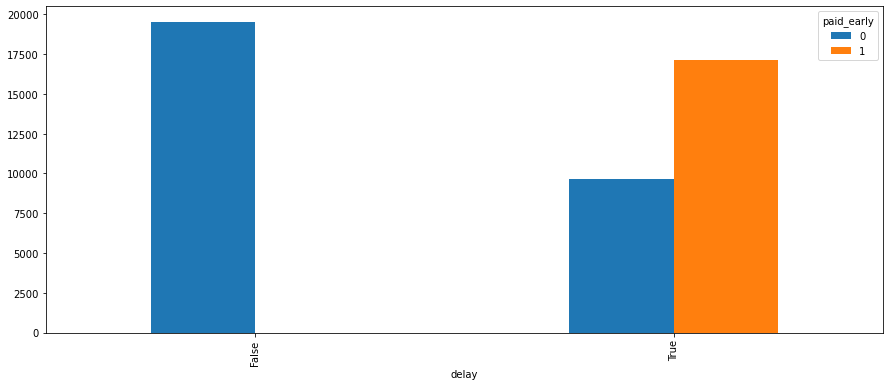

In [32]:
#visualizing if the target variable(delay) is balanced or not 
pd.crosstab(data.delay == 0,data.paid_early).plot(kind="bar",figsize=(15,6))

<AxesSubplot:>

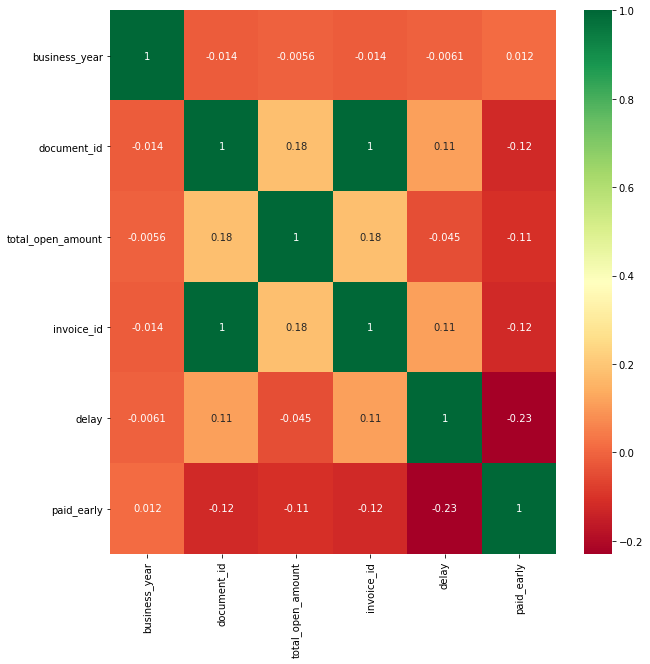

In [33]:
#getting the correlation between dependent and independent variables i.e all nummericals columns
plt.figure(figsize = (10,10))
sns.heatmap(data.corr() , annot = True , cmap="RdYlGn")

In [34]:
#correlation values between dependent and independent variables i.e all nummericals columns
data.corr()

,business_year,document_id,total_open_amount,invoice_id,delay,paid_early
business_year,1.000000,-0.014128,-0.005614,-0.014128,-0.006104,0.011928
document_id,-0.014128,1.000000,0.180642,1.000000,0.112605,-0.119642
total_open_amount,-0.005614,0.180642,1.000000,0.180642,-0.044531,-0.105453
invoice_id,-0.014128,1.000000,0.180642,1.000000,0.112605,-0.119642
delay,-0.006104,0.112605,-0.044531,0.112605,1.000000,-0.229727
paid_early,0.011928,-0.119642,-0.105453,-0.119642,-0.229727,1.000000


<AxesSubplot:>

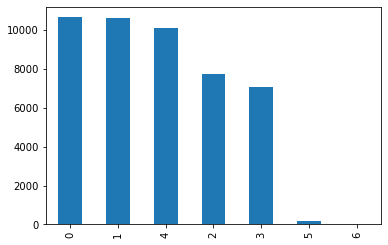

In [35]:
#visualizing day of the week on which payment has been done by the customer
data.clear_date.dt.weekday.value_counts().plot(kind = 'bar')

<AxesSubplot:>

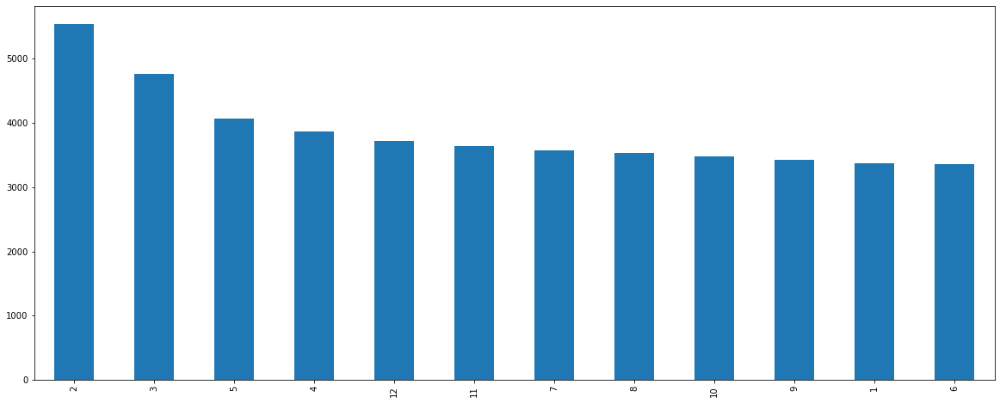

In [36]:
#visualizing on which month payment has been done by the customer
data.clear_date.dt.month.value_counts().plot(kind = 'bar', figsize = (20,8))

<AxesSubplot:>

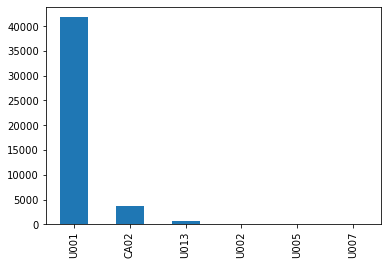

In [37]:
#counting the number of customer assined a particular busiess code
data.business_code.value_counts().plot(kind = 'bar')

In [38]:
#visualizing a interactive scatter plot to understand the relation between delay and total open amount
fig = px.scatter(data, x= 'delay' , y = 'total_open_amount', color='business_year', width = 1000)
fig.show()

<AxesSubplot:>

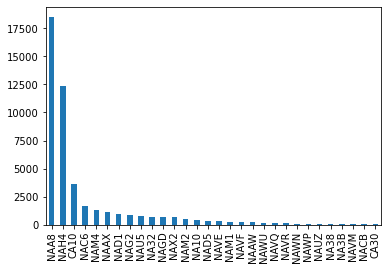

In [39]:
#visualizing the count of each customer payment terms
data.customer_payment_terms.value_counts()[:30].plot(kind = 'bar')

In [40]:
#understanding the relation between delay and customer payment terms wrt to 6 different business codes
fig = px.scatter(data, x= 'delay' , y = 'customer_payment_terms', facet_col = 'business_code', width = 3000)
fig.show()

###### How due date is calculated?
  - So due date is calculated by adding customer payment terms to baseline date,i.e **baseline date + customer payment terms**
  - So let's visualize the amount of time given to a particular customer from the baseline date i.e which is more or less equal to the date of creation of invoice document by engineering a new feature  **provision time** that is basically the difference between baseline date and due date.

In [41]:
#provision time- how much time is been given to a particular company from the baseline date
data['provision_time'] = data.due_date - data.baseline_create_date
data.provision_time = data.provision_time.apply(lambda x: x.days)

In [42]:
data.tail().T #displaying the transpose of the first 5 rows of the dataset

,46329,46330,46331,46332,46333
business_code,U001,U013,U001,U001,U001
customer_number,0200762301,0140103592,0200762301,0200762301,CCU002
customer_name,C&S WH corporation,COMERCI,C&S WH corp,C&S WH,KRFT FDS corporation
clear_date,2019-02-01 00:00:00,2019-08-13 00:00:00,2019-12-19 00:00:00,2019-11-07 00:00:00,2019-11-01 00:00:00
business_year,2019,2019,2019,2019,2019
document_id,1.92864e+09,1.99183e+09,1.93022e+09,1.93004e+09,1.92991e+09
posting_date,2019-01-17 00:00:00,2019-06-14 00:00:00,2019-12-04 00:00:00,2019-10-23 00:00:00,2019-09-25 00:00:00
document_create_date,2019-01-17 00:00:00,2019-06-12 00:00:00,2019-12-04 00:00:00,2019-10-22 00:00:00,2019-09-23 00:00:00
invoice_doc_create_date,2019-01-17 00:00:00,2019-06-14 00:00:00,2019-12-04 00:00:00,2019-10-23 00:00:00,2019-09-25 00:00:00
due_date,2019-02-01 00:00:00,2019-08-13 00:00:00,2019-12-19 00:00:00,2019-11-07 00:00:00,2019-10-30 00:00:00


<AxesSubplot:>

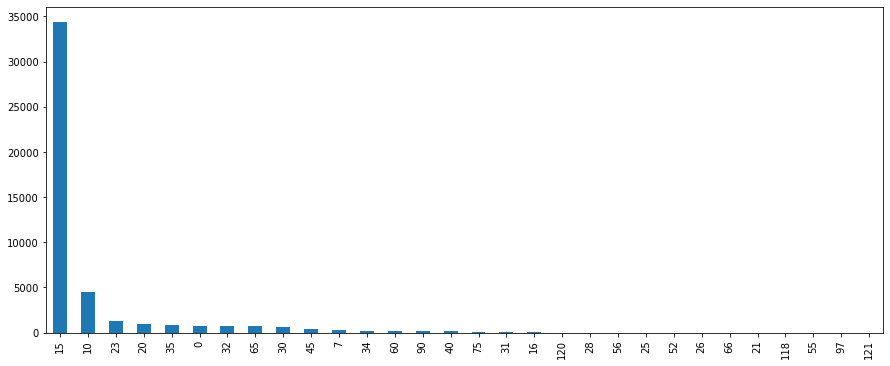

In [43]:
#visualizing the count of companies wrt the provision time given to them to make the payment
data.provision_time.value_counts().plot(kind='bar',figsize=(15,6))

In [44]:
#here is amount of provision time given to a company according to payment terms wrt the different business codes
fig = px.scatter(data, x= 'provision_time' , y = 'customer_payment_terms' , width = 1000)
fig.show()

## Feature Engineering<a id='task_4'></a>

**__Invoice Level Features__**

 - **paid_invoices** - Number of paid invoices prior to the creation date of a new invoice of a customer. 
 - **late_paid_invoices** - Number of invoices which were paid late prior to the creation date of a new invoice of a customer 
 - **ratio_late_paid_invoices** - late_paid_invoices / paid_invoices
 - **total_amount_paid_invoices** - The sum of the base amount from all the paid invoices prior to the creation of new invoice for a customer.
 - **total_amount_late_paid_invoices** - The sum of the base amount from all the paid invoices which were late prior to the creation of new invoice for a customer. 
 - **ratio_amount_late_paid_invoices** - total_amount_late_paid_invoices / total_amount_paid_invoices
 - **average_days_late** - Average days late of all paid invoices that were late prior to the creation date of a new invoice for a customer.
 - **total_outstanding_invoices** - Number of the outstanding invoices prior to the creation date of a new invoice of a customer. 
 - **total_late_outstanding_invoices** - Number of the outstanding invoices which were late prior to the creation date of a new invoice of a customer.
 - **ratio_late_outstanding_invoices** - total_late_outstanding_invoices / total_outstanding_invoices
 - **total_amount_outstanding_invoices** - The sum of the base amount from all the outstanding invoices prior to the creation of new invoice for a customer.
 - **total_amount_late_outstanding_invoices** - The sum of the base amount from all the outstanding invoices which were late prior to the creation of new invoice for a customer. 
 - **ratio_amount_late_outstanding_invoices** - total_amount_late_outstanding_invoices / total_amount_outstanding_invoices
 - **average_days_late_outstanding_invoices** - Average days late of all outstanding invoices that were late prior to the creation of new invoice for a customer.

In [45]:
#sorting the dataset wrt invoice document create date to engineer features correctly
df = data.sort_values(by = 'invoice_doc_create_date')

In [46]:
#reseting index and droping the default index column
df = df.reset_index(drop=True)
df.head()

,business_code,customer_number,customer_name,clear_date,business_year,document_id,posting_date,document_create_date,invoice_doc_create_date,due_date,invoice_currency,total_open_amount,baseline_create_date,customer_payment_terms,invoice_id,delay,paid_early,provision_time
0,U001,0200769623,WAL-MAR in,2019-01-09,2019.0,1.928534e+09,2018-12-30,2018-12-29,2018-12-30,2019-01-14,USD,29961.91,2018-12-30,NAH4,1.928534e+09,0,1,15
1,CA02,0140106181,THE corp,2019-01-16,2019.0,2.960520e+09,2018-12-30,2018-12-30,2018-12-30,2019-01-10,CAD,92.91,2018-12-31,CA10,2.960520e+09,6,0,10
2,U001,0200769623,WAL-MAR associates,2019-01-10,2019.0,1.928543e+09,2018-12-30,2018-12-30,2018-12-30,2019-01-14,USD,5695.09,2018-12-30,NAH4,1.928543e+09,0,1,15
3,CA02,0140106408,WAL-M systems,2019-01-25,2019.0,2.960520e+09,2018-12-30,2018-12-30,2018-12-30,2019-01-09,CAD,131641.53,2018-12-30,CA10,2.960520e+09,16,0,10
4,U001,0200749782,KROG systems,2019-01-14,2019.0,1.928543e+09,2018-12-30,2018-12-30,2018-12-30,2019-01-14,USD,16314.22,2018-12-30,NAA8,1.928543e+09,0,0,15


In [47]:
#function to get the number of paid invoices prior to the creation date of a new invoice of a customer
def paid(name,date):
    #filtering paid invoices wrt a particular customer whose clear date is less than the creation date of new invoice
    return int(df.query('customer_name == @name and clear_date < @date').customer_name.count())

#function to get the number of invoices which were paid late prior to the creation date of a new invoice of a customer 
def late_paid(name,date):
    #filtering late paid invoices wrt a particular customer whose clear date is less than the creation date of new invoice and payments are delayed by certain days
    return int(df.query('customer_name == @name and clear_date < @date and delay > 0').customer_name.count())

#creating a new column to store the paid invoices of a particuar customer              
df['paid_inv'] = None
#creating a new column to store the late paid invoices of a particular customer
df['late_paid_inv'] = None

#initializing a for loop to pass the name and date of the creation of a new invoice to the specified functions
for i,v in enumerate(df.customer_name):
    df.paid_inv.loc[i] = paid(v,df.invoice_doc_create_date.loc[i])
    df.late_paid_inv.loc[i] = late_paid(v,df.invoice_doc_create_date.loc[i])

#convering the datatype of the columns to integer
df.paid_inv = pd.to_numeric(df.paid_inv)
df.late_paid_inv = pd.to_numeric(df.late_paid_inv)

In [48]:
#calculating the ratio of late paid invoices and the paid invoices of a particular customer
df['ratio_late_paid_inv'] = df['late_paid_inv']/df['paid_inv']

In [49]:
#function to get the sum of the base amount from all the paid invoices prior to the creation 
#of new invoice for a customer.
def amount_paid(name,date):
    #filtering sum of amount of the paid invoices wrt a particular customer whose clear date is less than
    #the creation date of new invoice
    return int(df.query('customer_name == @name and clear_date < @date').total_open_amount.sum())

#function to get the The sum of the base amount from all the paid invoices which were 
#late prior to the creation of new invoice for a customer.
def amount_late_paid(name,date):
    #filtering sum of amount of the late paid invoices wrt a particular customer whose clear date 
    #is less than the creation date of new invoice
    return int(df.query('customer_name == @name and clear_date < @date and delay > 0').total_open_amount.sum())

#creating a new column to store the sum of amount of the paid invoices of a particular customer
df['total_amount_paid'] = None
#creating a new column to store the sum of amount of the late paid invoices of a particular customer
df['total_amount_late_paid'] = None

#initializing a for loop to pass the name and date of the creation of a new invoice to the specified functions
for i,v in enumerate(df.customer_name):
    df['total_amount_paid'].loc[i] = amount_paid(v,df.invoice_doc_create_date.loc[i])
    df['total_amount_late_paid'].loc[i] = amount_late_paid(v,df.invoice_doc_create_date.loc[i])
    
#convering the datatype of the columns to integer
df.total_amount_paid = pd.to_numeric(df.total_amount_paid)
df.total_amount_late_paid = pd.to_numeric(df.total_amount_late_paid)

In [50]:
#calculating the ratio of sum of amount of the late paid invoices 
#and sum of amount of the late paid invoices of a particular customer
df['ratio_amount_late_paid'] = df.total_amount_late_paid / df.total_amount_paid

In [51]:
#function to get the Average days late of all paid invoices that were late 
#prior to the creation date of a new invoice for a customer.  
def days_late(name,date):
    #filtering late paid invoices wrt a particular customer whose clear date is less than the 
    #creation date of new invoice and returning the mean of total days delayed
    return df.query('customer_name == @name and clear_date < @date and delay > 0').delay.mean()

#creating a new column to store the mean of total days delayed
df['avg_days_late'] = None

#initializing a for loop to pass the name and date of the creation of a new invoice to the specified functions
for i,v in enumerate(df.customer_name):
    df['avg_days_late'].loc[i] = days_late(v,df.invoice_doc_create_date.loc[i])

#convering the datatype of the columns to integer
df.avg_days_late = pd.to_numeric(df.avg_days_late)

In [52]:
#function to get the number of outstanding invoices prior to the creation date of a new invoice of a customer
def outstanding_invoices(name, date):
    #filtering outstanding invoices wrt a particular customer whose clear date 
    #is greater than the creation date of new invoice
    return int(df.query('customer_name == @name and invoice_doc_create_date < @date and clear_date > @date').invoice_id.count())

#function to get the number of late outstanding invoices prior to the creation date of a new invoice of a customer
def late_outstanding_invoices(name,date):
    #filtering late outstanding invoices wrt a particular customer whose clear date 
    #is less than the creation date of new invoice
    return int(df.query('customer_name == @name and invoice_doc_create_date < @date and due_date < @date and clear_date > @date').invoice_id.count())

#creating a new column to store the count of outstanding invoices of a particuar customer       
df['total_outstanding_inv'] = None
#creating a new column to store the count of outstanding invoices of a particuar customer       
df['total_late_outstanding_inv'] = None

#initializing a for loop to pass the name and date of the creation of a new invoice to the specified functions
for i,v in enumerate(df.customer_name):
    df['total_outstanding_inv'].loc[i] = outstanding_invoices(v,df.invoice_doc_create_date.loc[i])
    df['total_late_outstanding_inv'].loc[i] = late_outstanding_invoices(v,df.invoice_doc_create_date.loc[i])
    
#convering the datatype of the columns to integer
df.total_outstanding_inv = pd.to_numeric(df.total_outstanding_inv)
df.total_late_outstanding_inv = pd.to_numeric(df.total_late_outstanding_inv)

#calculating the ratio of total late outstanding inv and total outstanding inv
df['ratio_late_outstanding_inv'] = df.total_late_outstanding_inv / df.total_outstanding_inv

In [53]:
#calculating the ratio of total late outstanding inv and total outstanding inv
df['ratio_late_outstanding_inv'] = df.total_late_outstanding_inv / df.total_outstanding_inv

In [54]:
#function to get the sum of the base amount from all the outstanding invoices prior to the creation 
#of new invoice for a customer.
def amount_outstanding_inv(name, date):
    #filtering sum of amount of the outstanding invoices wrt a particular customer whose clear date is greater than
    #the creation date of new invoice
    return int(df.query('customer_name == @name and invoice_doc_create_date < @date and clear_date > @date').total_open_amount.sum())

#function to get the sum of the base amount from all the late outstanding invoices prior to the creation 
#of new invoice for a customer.
def amount_late_outstanding_inv(name, date):
    #filtering sum of amount of the late outstanding invoices wrt a particular customer whose clear date is greater than
    #the creation date of new invoice
    return int(df.query('customer_name == @name and invoice_doc_create_date < @date and due_date < @date and clear_date > @date').total_open_amount.sum())

#creating a new column to store the sum of amount of the outstanding invoices of a particular customer
df['total_outstanding_amount'] = None
#creating a new column to store the sum of amount of the late outstanding invoices of a particular customer
df['total_late_outstanding_amount'] = None

#initializing a for loop to pass the name and date of the creation of a new invoice to the specified functions
for i,v in enumerate(df.customer_name):
    df['total_outstanding_amount'].loc[i] = amount_outstanding_inv(v, df.invoice_doc_create_date.loc[i])
    df['total_late_outstanding_amount'].loc[i] = amount_late_outstanding_inv(v, df.invoice_doc_create_date.loc[i])
    
#convering the datatype of the columns to integer
df['total_outstanding_amount'] = pd.to_numeric(df.total_outstanding_amount)
df['total_late_outstanding_amount'] = pd.to_numeric(df.total_late_outstanding_amount)

In [55]:
df.tail(20)#displaying last 20 rows of the dataset

,business_code,customer_number,customer_name,clear_date,business_year,document_id,posting_date,document_create_date,invoice_doc_create_date,due_date,...,ratio_late_paid_inv,total_amount_paid,total_amount_late_paid,ratio_amount_late_paid,avg_days_late,total_outstanding_inv,total_late_outstanding_inv,ratio_late_outstanding_inv,total_outstanding_amount,total_late_outstanding_amount
46307,U001,0200769623,WAL-MAR trust,2020-03-13,2020.0,1.930570e+09,2020-02-26,2020-02-25,2020-02-26,2020-03-12,...,0.181818,23873814,3729295,0.156209,3.484043,22,0,0.000000,572705,0
46308,U001,0200744019,TARG,2020-03-12,2020.0,1.930566e+09,2020-02-26,2020-02-25,2020-02-26,2020-03-12,...,0.769231,1778200,1373196,0.772239,6.400000,2,0,0.000000,45981,0
46309,U001,0200980828,BEN E associates,2020-03-09,2020.0,1.930571e+09,2020-02-26,2020-02-26,2020-02-26,2020-03-12,...,0.000000,94301,0,0.000000,NaN,0,0,NaN,0,0
46310,U001,0200769623,WAL-MAR llc,2020-03-12,2020.0,1.930569e+09,2020-02-26,2020-02-25,2020-02-26,2020-03-12,...,0.175719,21870600,3202129,0.146412,4.818182,24,2,0.083333,423682,5481
46311,U001,0200759878,SA in,2020-03-13,2020.0,1.930562e+09,2020-02-26,2020-02-24,2020-02-26,2020-03-12,...,0.620438,4307789,2327206,0.540232,4.741176,3,0,0.000000,153512,0
46312,U001,0200913718,TREEHOU in,2020-03-16,2020.0,1.930570e+09,2020-02-26,2020-02-25,2020-02-26,2020-03-27,...,NaN,0,0,NaN,NaN,0,0,NaN,0,0
46313,CA02,0140106408,WAL-M corp,2020-03-12,2020.0,2.960617e+09,2020-02-26,2020-02-26,2020-02-26,2020-03-08,...,1.000000,3208055,3208055,1.000000,8.600000,2,0,0.000000,101152,0
46314,U001,0200769623,WAL-MAR trust,2020-03-16,2020.0,1.930569e+09,2020-02-26,2020-02-25,2020-02-26,2020-03-12,...,0.181818,23873814,3729295,0.156209,3.484043,22,0,0.000000,572705,0
46315,U001,0200769623,WAL-MAR systems,2020-03-09,2020.0,1.930553e+09,2020-02-26,2020-02-21,2020-02-26,2020-03-12,...,0.168551,23174150,3347303,0.144441,4.512195,31,4,0.129032,619415,18956
46316,U001,0200793568,SUPE corporation,2020-03-13,2020.0,1.930570e+09,2020-02-26,2020-02-26,2020-02-26,2020-03-12,...,0.548387,3716804,2175564,0.585332,2.852941,1,0,0.000000,23916,0


In [56]:
#calculating the ratio of total late outstanding amount and total outstanding amount

df['ratio_late_outstanding_amount'] = df['total_late_outstanding_amount'] / df['total_outstanding_amount']

In [57]:
#function to get the Average days late of all the late outstanding invoices  
#prior to the creation date of a new invoice for a customer.
def days_late_outstanding(name,date):
    #filtering late outstanding invoices wrt a particular customer whose clear date is less than the 
    #creation date of new invoice and returning the mean of total days delayed
    return df.query('customer_name == @name and invoice_doc_create_date < @date and due_date < @date and clear_date > @date').delay.mean()

#creating a new column to store the mean of total days delayed
df['avg_days_late_outstanding'] = None

#initializing a for loop to pass the name and date of the creation of a new invoice to the specified functions
for i,v in enumerate(df.customer_name):
    df['avg_days_late_outstanding'].loc[i] = days_late_outstanding(v,df.invoice_doc_create_date.loc[i])

#convering the datatype of the columns to integer
df['avg_days_late_outstanding'] = pd.to_numeric(df['avg_days_late_outstanding'])

In [58]:
#dropping all the columns which are not required as they cannot be fed into the model
cols = ['customer_number', 'customer_name', 'clear_date', 'document_id', 'posting_date', 
        'document_create_date', 'invoice_doc_create_date', 'due_date', 'baseline_create_date', 
        'invoice_id', 'paid_early', 'provision_time']

df1 = df.drop(labels = cols, axis =1)

In [59]:
df1.head().T #displaying transpose of first 5 rows of the remaining dataset

,0,1,2,3,4
business_code,U001,CA02,U001,CA02,U001
business_year,2019,2019,2019,2019,2019
invoice_currency,USD,CAD,USD,CAD,USD
total_open_amount,29961.9,92.91,5695.09,131642,16314.2
customer_payment_terms,NAH4,CA10,NAH4,CA10,NAA8
delay,0,6,0,16,0
paid_inv,0,0,0,0,0
late_paid_inv,0,0,0,0,0
ratio_late_paid_inv,NaN,NaN,NaN,NaN,NaN
total_amount_paid,0,0,0,0,0


In [60]:
#replacing all the null values with 0
df1.fillna(0, inplace = True)

In [61]:
#displaying transpose of first 5 rows of the remaining dataset
df1.head().T

,0,1,2,3,4
business_code,U001,CA02,U001,CA02,U001
business_year,2019,2019,2019,2019,2019
invoice_currency,USD,CAD,USD,CAD,USD
total_open_amount,29961.9,92.91,5695.09,131642,16314.2
customer_payment_terms,NAH4,CA10,NAH4,CA10,NAA8
delay,0,6,0,16,0
paid_inv,0,0,0,0,0
late_paid_inv,0,0,0,0,0
ratio_late_paid_inv,0,0,0,0,0
total_amount_paid,0,0,0,0,0


In [62]:
#storing the new dataset on local disk
df1.to_csv('final_data.csv')

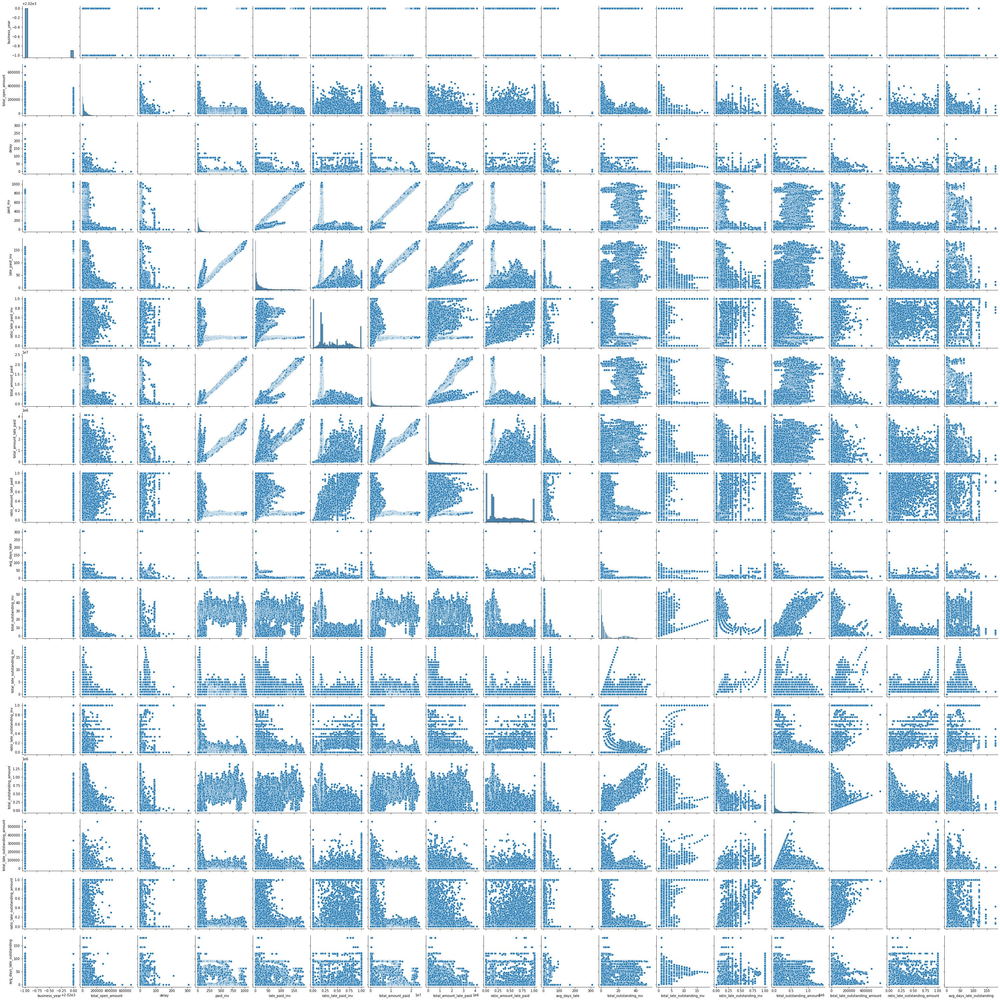

In [63]:
#visualizing pairplots between all the features to understand which regression model
#will help us the most
sns.pairplot(df1)

In [64]:
df1.head(10).T

,0,1,2,3,4,5,6,7,8,9
business_code,U001,CA02,U001,CA02,U001,U001,CA02,U001,U001,U001
business_year,2019,2019,2019,2019,2019,2019,2019,2019,2019,2019
invoice_currency,USD,CAD,USD,CAD,USD,USD,CAD,USD,USD,USD
total_open_amount,29961.9,92.91,5695.09,131642,16314.2,35530.1,4612.95,12970.8,15427.4,16049.9
customer_payment_terms,NAH4,CA10,NAH4,CA10,NAA8,NAC6,CA10,NAH4,NAH4,NAH4
delay,0,6,0,16,0,1,8,0,0,0
paid_inv,0,0,0,0,0,0,0,0,0,0
late_paid_inv,0,0,0,0,0,0,0,0,0,0
ratio_late_paid_inv,0,0,0,0,0,0,0,0,0,0
total_amount_paid,0,0,0,0,0,0,0,0,0,0


### One-hot encoding of catagorical variables

In [65]:
#one hot encoding catagorical features to elevate model's performance
cols = ['business_code', 'business_year' , 'invoice_currency', 
        'customer_payment_terms']

df1 = pd.get_dummies(df1 ,columns = cols)

In [66]:
#shape of the resultant dataset
df1.shape

(46327, 97)

### Normalizing the data

 - Now we can see all our numericals values are in different range which results in poor model performance,therefore we need to normalize our numerical variable to a range **0-1.**

In [67]:
#import MinMaxScaler from sklearn to normalize the numerical features
from sklearn.preprocessing import MinMaxScaler

#initializing a variable to store the target feature
y = df1.delay
#dropping the target feature from the dataset
df1.drop(['delay'] , axis =1, inplace = True)

#initializing the scaler function 
scaler = MinMaxScaler()
#storing the independent feature to a variable x 
X = pd.DataFrame(data = df1)
#fitting and transposing all the numerical features
X[:] = scaler.fit_transform(X[:])


### Splitting the dataset into Train and Validation<a id='task_5'></a>

In [68]:
#importing all the libraries and algorithms required for model building, 
#evaluation metrics and splitting the dataset

from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor , GradientBoostingRegressor
import xgboost

In [69]:
#splitting the dataset into training and testing dataset with 70:30 ratio, to avoid overfitting 
X_train, X_val, y_train, y_val = train_test_split(X, 
                                                  y, 
                                                  test_size = 0.3, 
                                                  random_state = 20)


#printing the number of rows in train and test
print("Training set has {} samples.".format(X_train.shape[0]))
print("Validation set has {} samples.".format(X_val.shape[0]))

Training set has 32428 samples.
Validation set has 13899 samples.


### Model Building<a id='task_6'></a>

In [70]:
#function to evaluate all my models and store their respective evaluation metrics
#- R2 score, RMSE(root sq mean square error) , MAE(mean absolute error) results in a dictionary 
from yellowbrick.regressor import prediction_error
#passing certain arguments to the function, where
#learner - model algorithm , sample_size - size of the sample
def train_predict(learner, sample_size, X_train, y_train, X_val, y_val): 
    #initializing a new dictionary to store each model's result
    results = {}
    #tracking the time taken to train  a particular model 
    start = time()
    #fitting the model
    learner = learner.fit(X_train[:sample_size] , y_train[:sample_size])
    end = time() 
    
    #storing the total time taken to train by a particular model
    results['train_time'] = end - start
    
    #tracking the time taken for testing by a particular model
    start = time()
    #prediction on test dataset
    predictions_val = learner.predict(X_val)
    #prediction on train dataset
    predictions_train = learner.predict(X_train[:300])
    end = time() 
    
    #storing the total time taken to test by a particular model 
    results['pred_time'] = end - start
    
    #evaluating the train predictions using r2 score, RMSE , MAE
    #and storing the metrics in the result dictionary
    results['r2_train'] = r2_score(y_train[:300], predictions_train)
    results['rmse_train'] = np.sqrt(mean_squared_error(y_train[:300] , predictions_train))
    results['mae_train'] = mean_absolute_error(y_train[:300] , predictions_train)
    
    #evaluating the test predictions using r2 score, RMSE , MAE
    #and storing the metrics in the result dictionary
    results['r2_val'] = r2_score(y_val, predictions_val)
    results['rmse_val'] = np.sqrt(mean_squared_error(y_val , predictions_val))
    results['mae_val'] = mean_absolute_error(y_val , predictions_val)
    
    #printing the name of the model algorithm and the number of samples it is being trained on 
    print("{} trained on {} samples.".format(learner.__class__.__name__, sample_size))
    #visualizing a scatter plot between actual values(y_test) and predicted values(predictions_test)
    if sample_size == 32428:
        #getting the prediction error plot
        visualizer = prediction_error(learner, X_train, y_train, X_val, y_val)
    
    #returning the dictionary containing all the performance information about each model
    return results

In [71]:
#function to get the feature importance according to a particular model
def get_features(model):
    #getting all the columns name
    feature = X_train.columns
    #creating a series containing the percentage of importance that is shown by a particular  
    #column in predicting the target feature(delay)
    feature_importance = pd.Series(model.feature_importances_, index=feature).to_dict()
    x = sorted(feature_importance.items(), key=lambda x: x[1], reverse=True)
    for name, importance in x:
        print(f"{name:<30}: {importance:>6.2%}")
  
    #printing the feature importance in a sorted order
    print(f"\nTotal importance: {sum(feature_importance.values()):.2%}")
    return feature_importance

In [72]:
#function to plot the feature weight and cumulative weight of top 6 most predictive features 
#passing feature importance of a particular model
def feature_plot(importances, X_train, y_train):
    
    indices = np.argsort(importances)[::-1]
    columns = X_train.columns.values[indices[:6]]
    values = importances[indices][:6]

    fig = plt.figure(figsize = (9,6))
    plt.title("Normalized Weights for First Six Most Predictive Features", fontsize = 12)
    plt.bar(np.arange(6), values, width = 0.4, align="center", color = '#00A000', label = "Feature Weight")
    plt.bar(np.arange(6) - 0.3, np.cumsum(values), width = 0.3, align = "center", color = '#00A0A0', label = "Cumulative Feature Weight")
    plt.xticks(np.arange(6), columns)
    plt.xlim((-0.5, 6))
    plt.ylabel("Weight", fontsize = 12)
    plt.xlabel("Feature", fontsize = 12)
    
    plt.legend(loc = 'upper center')
    plt.tight_layout()
    plt.show()  

After creating all the necessary helper functions required for evaluation and visualization, next we will fit 6   different models and choose the best model by optimizing them.

> Here I am using the following models:
>1) Linear Regression
>2) Support Vector Regressor
>3) K Nearest Neighbor Regressor
>4) Random Forest Regressor
>5) Gradient Boosting Regressor
>6) Xgboost Regressor

LinearRegression trained on 324 samples.
LinearRegression trained on 3242 samples.
LinearRegression trained on 32428 samples.


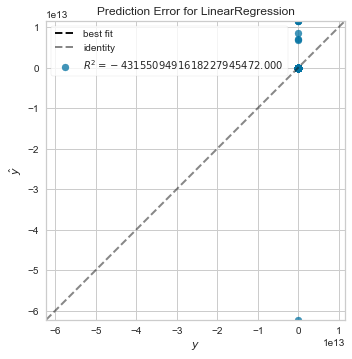

SVR trained on 324 samples.
SVR trained on 3242 samples.
SVR trained on 32428 samples.


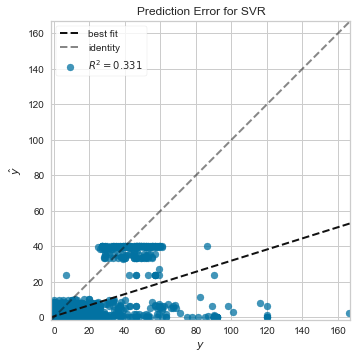

KNeighborsRegressor trained on 324 samples.
KNeighborsRegressor trained on 3242 samples.
KNeighborsRegressor trained on 32428 samples.


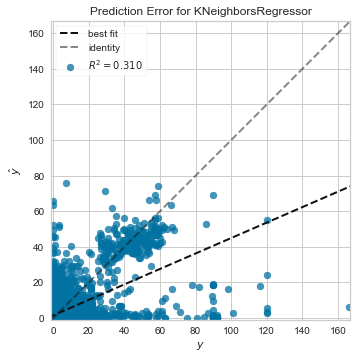

RandomForestRegressor trained on 324 samples.
RandomForestRegressor trained on 3242 samples.
RandomForestRegressor trained on 32428 samples.


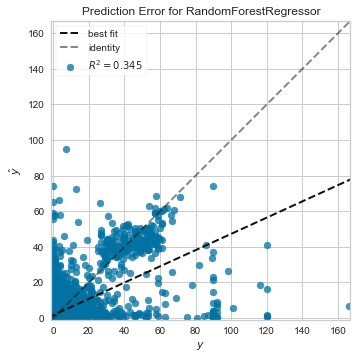

GradientBoostingRegressor trained on 324 samples.
GradientBoostingRegressor trained on 3242 samples.
GradientBoostingRegressor trained on 32428 samples.


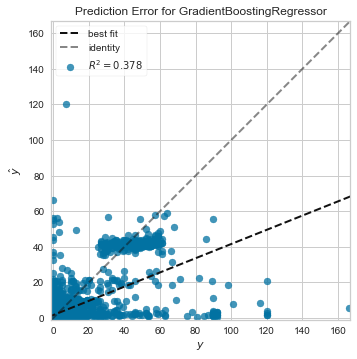

XGBRegressor trained on 324 samples.
XGBRegressor trained on 3242 samples.
XGBRegressor trained on 32428 samples.


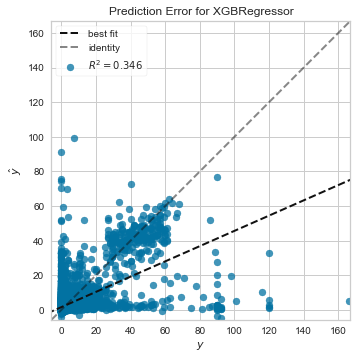

In [73]:
#Initializing all the models with default parameters
reg_A = LinearRegression()
reg_B = SVR()
reg_C = KNeighborsRegressor() 
reg_D = RandomForestRegressor()
reg_E = GradientBoostingRegressor()
reg_F = xgboost.XGBRegressor()

#splitting the total dataset into samples just for better understanding of the model's performance
samples_100 = len(X_train)
samples_10 =int(len(X_train)/10)
samples_1 = int(len(X_train)/100)

#initializing the dictionary to store the models information
results = {} 
#for-loop for iterating different model alorithms
for reg in [reg_A, reg_B, reg_C, reg_D, reg_E, reg_F]:
    reg_name = reg.__class__.__name__
    results[reg_name] = {}
    for i, samples in enumerate([samples_1, samples_10, samples_100]):
        results[reg_name][i] = train_predict(reg, samples, X_train, y_train, X_val, y_val)

In [74]:
#printing the performance of different models in the form of dataframe
for iterator in results.items():
    print(iterator[0])
    display(pd.DataFrame(iterator[1]).rename(columns = {0:'1%' , 1:'10%' , 2:'100%'}))

LinearRegression


,1%,10%,100%
train_time,0.044936,3.690124e-02,3.590400e-01
pred_time,0.057989,8.974314e-03,7.978439e-03
r2_train,0.570835,4.924480e-01,4.953407e-01
rmse_train,6.083175,6.615433e+00,6.596554e+00
mae_train,2.210412,2.352282e+00,2.406680e+00
r2_val,0.291143,-2.523160e+20,-4.315509e+21
rmse_val,7.251622,1.368133e+11,5.658118e+11
mae_val,2.827890,7.861274e+09,8.604048e+09


SVR


,1%,10%,100%
train_time,0.017911,1.178831,131.287825
pred_time,0.395979,3.741180,38.429356
r2_train,0.036884,0.311068,0.461900
rmse_train,9.112914,7.707369,6.811609
mae_train,2.548356,2.293266,1.986489
r2_val,0.028597,0.236111,0.330504
rmse_val,8.488985,7.527854,7.047415
mae_val,2.442517,2.157259,1.956681


KNeighborsRegressor


,1%,10%,100%
train_time,0.009148,0.066885,1.392143
pred_time,0.470862,2.060523,10.777493
r2_train,0.532431,0.622477,0.526796
rmse_train,6.349520,5.705448,6.387665
mae_train,2.334000,1.934000,2.299333
r2_val,0.221496,0.275846,0.309770
rmse_val,7.599524,7.329449,7.155712
mae_val,2.665803,2.497762,2.494467


RandomForestRegressor


,1%,10%,100%
train_time,0.328070,3.569182,50.767678
pred_time,0.127658,0.237097,0.446344
r2_train,0.913199,0.910362,0.919427
rmse_train,2.735768,2.780121,2.635796
mae_train,1.015167,0.975533,0.971488
r2_val,0.230306,0.306120,0.344568
rmse_val,7.556399,7.174609,6.972999
mae_val,2.825828,2.561113,2.463642


GradientBoostingRegressor


,1%,10%,100%
train_time,0.111700,0.955516,11.229186
pred_time,0.036870,0.036896,0.035922
r2_train,0.968679,0.665899,0.502733
rmse_train,1.643370,5.367310,6.548065
mae_train,1.040732,2.044562,2.386939
r2_val,0.233017,0.352392,0.377519
rmse_val,7.543082,6.931257,6.795461
mae_val,2.711442,2.416755,2.383882


XGBRegressor


,1%,10%,100%
train_time,0.765220,0.529584,3.160127
pred_time,0.043883,0.041888,0.044879
r2_train,0.999967,0.981223,0.733430
rmse_train,0.053375,1.272412,4.794285
mae_train,0.033546,0.827899,1.934535
r2_val,-0.014591,0.148522,0.346325
rmse_val,8.675639,7.947723,6.963647
mae_val,2.939636,2.736869,2.373033


### Model Hyperparameter Optimization Using GridSearchCV<a id='task_7'></a>

Now I will optimize these models using ___GridSearchCV___ to choose the best parameters and check which optimized model is performing better with respect to R2 score, Mean square Error and Mean absolute Error.

In [75]:
#import gridsearchcv from sklearn library
from sklearn.model_selection import GridSearchCV

#Initializing the model
reg = KNeighborsRegressor()

#parameters that we are going to optimize 
parameters = {'n_neighbors' : [9,11,15,17,19]
             }

#creating the optimizer object
grid_obj_neighbors = GridSearchCV(reg , parameters , cv=5 , n_jobs=-1)

#fitting the obj to out dataset
grid_fit_neighbors = grid_obj_neighbors.fit(X_train,y_train)

#finding the best parameters 
best_reg = grid_fit_neighbors.best_estimator_

#predictions on unoptimized model
predictions = (reg.fit(X_train, y_train)).predict(X_val)

#predictions on optimized model 
best_predictions = best_reg.predict(X_val)

#priniting the scores of evaluation metrics of unoptimized and optimized model
print("Unoptimized KNeighbors model\n------")
print("R2 Score score on testing data: {:.4f}".format(r2_score(y_val, predictions)))
print("RMSE on testing data: {:.4f}".format(np.sqrt(mean_squared_error(y_val, predictions))))
print("MAE on testing data: {:.4f}".format(mean_absolute_error(y_val, predictions)))

print("\nOptimized KNeighbors Model\n------")
print("Final R2 Score score on testing data: {:.4f}".format(r2_score(y_val, best_predictions)))
print("Final RMSE on testing data: {:.4f}".format(np.sqrt(mean_squared_error(y_val, best_predictions))))
print("Final MAE on testing data: {:.4f}".format(mean_absolute_error(y_val, best_predictions)))
print("Final Hyperparameters: %s" %grid_fit_neighbors.best_params_)

Unoptimized KNeighbors model
------
R2 Score score on testing data: 0.3098
RMSE on testing data: 7.1557
MAE on testing data: 2.4945

Optimized KNeighbors Model
------
Final R2 Score score on testing data: 0.3716
Final RMSE on testing data: 6.8279
Final MAE on testing data: 2.3941
Final Hyperparameters: {'n_neighbors': 19}


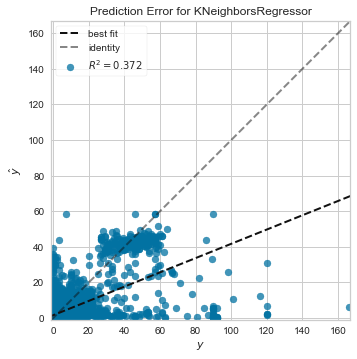

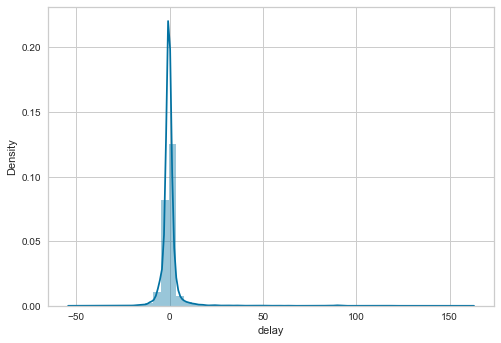

In [76]:
#import clone to clone the model optimized parmeters
from sklearn.base import clone
#cloning the best parameters we got by optimization for visualization
knn_model = (clone(best_reg)).fit(X_train,y_train)

#predicting X_test and storing in y variable
preds = knn_model.predict(X_val)
#getting the prediction error plot
visualizer = prediction_error(knn_model, X_train, y_train, X_val, y_val)
#visualizing the distplot to get the error 
ax = sns.distplot(y_val - preds, bins=50)
plt.show()

In [77]:
from sklearn.model_selection import GridSearchCV
#Initializing the model
reg1 = RandomForestRegressor()

#parameters that we are going to optimize
parameters = {'n_estimators' : [100,150,200,250],
              'min_samples_leaf' : [10,20,50],
             'max_depth': [3,5,6,7]
             }

#creating the optimizer object
grid_obj_forest = GridSearchCV(reg1 , parameters , scoring = 'r2' , n_jobs=-1)
#fitting the obj to out dataset
grid_fit_forest = grid_obj_forest.fit(X_train,y_train)
#finding the best parameters 
best_reg1 = grid_fit_forest.best_estimator_

#predictions on unoptimized model
predictions = (reg1.fit(X_train, y_train)).predict(X_val)

#predictions on optimized model
best_predictions = best_reg1.predict(X_val)

#priniting the scores of evaluation metrics of unoptimized and optimized model
print("Unoptimized RandomForestRegressor model\n------")
print("R2 Score score on testing data: {:.4f}".format(r2_score(y_val, predictions)))
print("RMSE on testing data: {:.4f}".format(np.sqrt(mean_squared_error(y_val, predictions))))
print("MAE on testing data: {:.4f}".format(mean_absolute_error(y_val, predictions)))

print("\nOptimized RandomForestRegressor Model\n------")
print("Final R2 Score score on testing data: {:.4f}".format(r2_score(y_val, best_predictions)))
print("Final RMSE on testing data: {:.4f}".format(np.sqrt(mean_squared_error(y_val, best_predictions))))
print("Final MAE on testing data: {:.4f}".format(mean_absolute_error(y_val, best_predictions)))
print("Final Hyperparameters: %s" %grid_fit_forest.best_params_)

Unoptimized RandomForestRegressor model
------
R2 Score score on testing data: 0.3360
RMSE on testing data: 7.0183
MAE on testing data: 2.4701

Optimized RandomForestRegressor Model
------
Final R2 Score score on testing data: 0.3970
Final RMSE on testing data: 6.6884
Final MAE on testing data: 2.3904
Final Hyperparameters: {'max_depth': 7, 'min_samples_leaf': 10, 'n_estimators': 100}


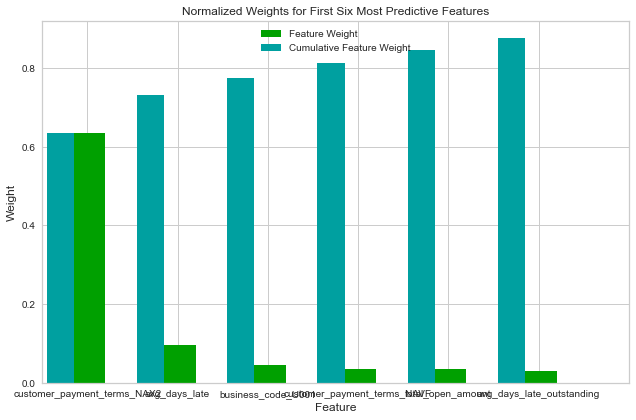

customer_payment_terms_NAX2   : 63.45%
avg_days_late                 :  9.61%
business_code_U001            :  4.52%
customer_payment_terms_NAVF   :  3.61%
total_open_amount             :  3.49%
avg_days_late_outstanding     :  2.96%
customer_payment_terms_NAG2   :  2.31%
paid_inv                      :  1.57%
customer_payment_terms_NAD5   :  1.24%
total_amount_late_paid        :  0.86%
total_amount_paid             :  0.83%
total_late_outstanding_amount :  0.62%
ratio_late_paid_inv           :  0.59%
business_code_CA02            :  0.58%
customer_payment_terms_CA10   :  0.53%
invoice_currency_CAD          :  0.53%
total_outstanding_amount      :  0.51%
invoice_currency_USD          :  0.39%
ratio_amount_late_paid        :  0.37%
ratio_late_outstanding_inv    :  0.32%
total_outstanding_inv         :  0.27%
customer_payment_terms_NAA8   :  0.25%
ratio_late_outstanding_amount :  0.22%
late_paid_inv                 :  0.21%
total_late_outstanding_inv    :  0.11%
business_year_2019.0     

In [78]:
#cloning the best parameters we got by optimization 
forest_model = (clone(best_reg1)).fit(X_train,y_train)
#getting the feature importance by RandomForest model 
importances = forest_model.feature_importances_

#calling the helper function to plot 6 top predictive features 
feature_plot(importances, X_train, y_train)
#printing the importance of all the features in the form of percentage
feat_forest = get_features(forest_model)

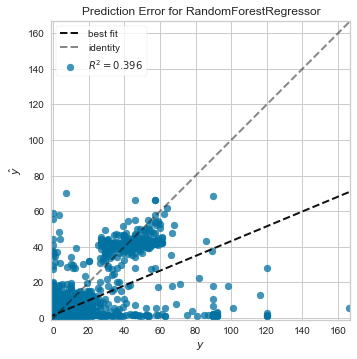

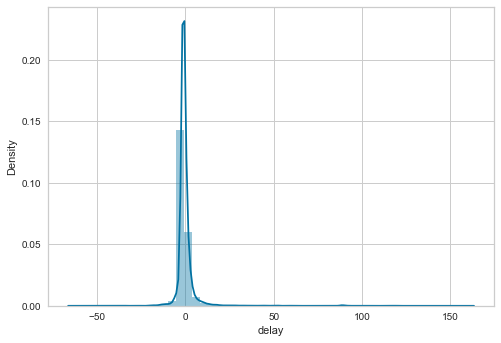

In [79]:
#predicting X_test and storing in preds variable
preds = forest_model.predict(X_val)
#getting the prediction error plot
visualizer = prediction_error(forest_model , X_train, y_train, X_val, y_val)
#visualizing the distplot to get the error 
ax = sns.distplot(y_val - preds, bins=50)
plt.show()

In [80]:
#initializing the model
reg2 = GradientBoostingRegressor()
#parameters that we are going to optimize
parameters = {'n_estimators' : [100,150,200,250],
             'max_depth': [4,5,6,7],
             }

#creating the optimizer object
grid_obj_gboost = GridSearchCV(reg2 , parameters , scoring = 'r2' , n_jobs=-1)
#fitting the obj to out dataset
grid_fit_gboost = grid_obj_gboost.fit(X_train,y_train)
#finding the best parameters 
best_reg2 = grid_fit_gboost.best_estimator_

#predictions on unoptimized model
predictions = (reg2.fit(X_train, y_train)).predict(X_val)
#predictions on optimized model
best_predictions = best_reg2.predict(X_val)

#priniting the scores of evaluation metrics of unoptimized and optimized model
print("Unoptimized GradientBoosting Regressor model\n------")
print("R2 Score score on testing data: {:.4f}".format(r2_score(y_val, predictions)))
print("RMSE on testing data: {:.4f}".format(np.sqrt(mean_squared_error(y_val, predictions))))
print("MAE on testing data: {:.4f}".format(mean_absolute_error(y_val, predictions)))

print("\nOptimized GradientBoosting Model\n------")
print("Final R2 Score score on testing data: {:.4f}".format(r2_score(y_val, best_predictions)))
print("Final RMSE on testing data: {:.4f}".format(np.sqrt(mean_squared_error(y_val, best_predictions))))
print("Final MAE on testing data: {:.4f}".format(mean_absolute_error(y_val, best_predictions)))
print("Final Hyperparameters: %s" %grid_fit_gboost.best_params_)

Unoptimized GradientBoosting Regressor model
------
R2 Score score on testing data: 0.3788
RMSE on testing data: 6.7887
MAE on testing data: 2.3835

Optimized GradientBoosting Model
------
Final R2 Score score on testing data: 0.3906
Final RMSE on testing data: 6.7236
Final MAE on testing data: 2.3425
Final Hyperparameters: {'max_depth': 4, 'n_estimators': 100}


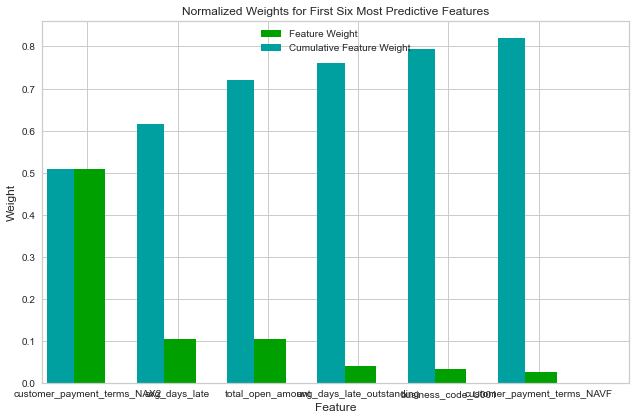

customer_payment_terms_NAX2   : 50.94%
avg_days_late                 : 10.53%
total_open_amount             : 10.49%
avg_days_late_outstanding     :  4.09%
business_code_U001            :  3.28%
customer_payment_terms_NAVF   :  2.69%
customer_payment_terms_NAM3   :  2.11%
total_amount_paid             :  1.50%
customer_payment_terms_NAG2   :  1.46%
customer_payment_terms_CA10   :  1.41%
total_amount_late_paid        :  1.19%
paid_inv                      :  1.17%
ratio_amount_late_paid        :  1.10%
invoice_currency_USD          :  0.87%
ratio_late_paid_inv           :  0.85%
customer_payment_terms_NAD5   :  0.81%
customer_payment_terms_CAX2   :  0.74%
total_outstanding_amount      :  0.72%
ratio_late_outstanding_amount :  0.58%
customer_payment_terms_NAUX   :  0.51%
ratio_late_outstanding_inv    :  0.39%
total_late_outstanding_amount :  0.34%
business_code_U002            :  0.33%
customer_payment_terms_NAUI   :  0.28%
invoice_currency_CAD          :  0.27%
total_outstanding_inv    

In [81]:
#cloning the best parameters we got by optimization 
gboost_model = (clone(best_reg2)).fit(X_train, y_train)
#getting the feature importance by gboost model 
importances = gboost_model.feature_importances_
#calling the helper function to plot 6 top predictive features 
feature_plot(importances, X_train, y_train)
#printing the importance of all the features in the form of percentage
feat_gboost = get_features(gboost_model)

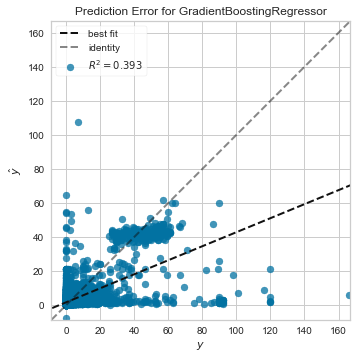

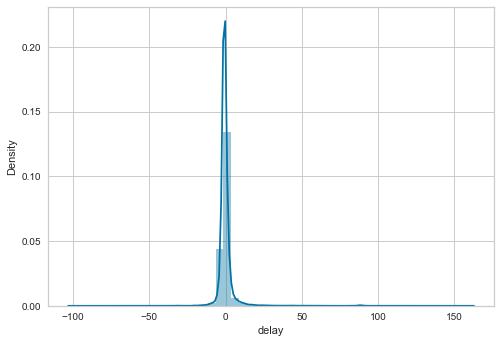

In [82]:
#predicting X_test and storing in preds variable
preds = gboost_model.predict(X_val)
#getting the prediction error plot
visualizer = prediction_error(gboost_model , X_train, y_train, X_val, y_val)
#visualizing the distplot to get the error 
ax = sns.distplot(y_val - preds, bins=50)
plt.show()

In [83]:
#initializing the model
reg3 = xgboost.XGBRegressor()
#parameters that we are going to optimize
parameters = {'n_estimators' : [70,100,150,200],
             'max_depth': [3,4,5,6],
             }

#creating the optimizer object
grid_obj_xgboost = GridSearchCV(reg3 , parameters , scoring = 'r2' , n_jobs=-1)
#fitting the obj to out dataset
grid_fit_xgboost = grid_obj_xgboost.fit(X_train,y_train)
#finding the best parameters 
best_reg3 = grid_fit_xgboost.best_estimator_

#predictions on unoptimized model
predictions = (reg3.fit(X_train, y_train)).predict(X_val)

#predictions on optimized model
best_predictions = best_reg3.predict(X_val)

#priniting the scores of evaluation metrics of unoptimized and optimized model
print("Unoptimized XGBoost Regressor model\n------")
print("R2 Score score on testing data: {:.4f}".format(r2_score(y_val, predictions)))
print("RMSE on testing data: {:.4f}".format(np.sqrt(mean_squared_error(y_val, predictions))))
print("MAE on testing data: {:.4f}".format(mean_absolute_error(y_val, predictions)))

print("\nOptimized XGBoost Regressor Model\n------")
print("Final R2 Score score on testing data: {:.4f}".format(r2_score(y_val, best_predictions)))
print("Final RMSE on testing data: {:.4f}".format(np.sqrt(mean_squared_error(y_val, best_predictions))))
print("Final MAE on testing data: {:.4f}".format(mean_absolute_error(y_val, best_predictions)))
print("Final Hyperparameters: %s" %grid_fit_xgboost.best_params_)

Unoptimized XGBoost Regressor model
------
R2 Score score on testing data: 0.3463
RMSE on testing data: 6.9636
MAE on testing data: 2.3730

Optimized XGBoost Regressor Model
------
Final R2 Score score on testing data: 0.3673
Final RMSE on testing data: 6.8508
Final MAE on testing data: 2.3562
Final Hyperparameters: {'max_depth': 3, 'n_estimators': 70}


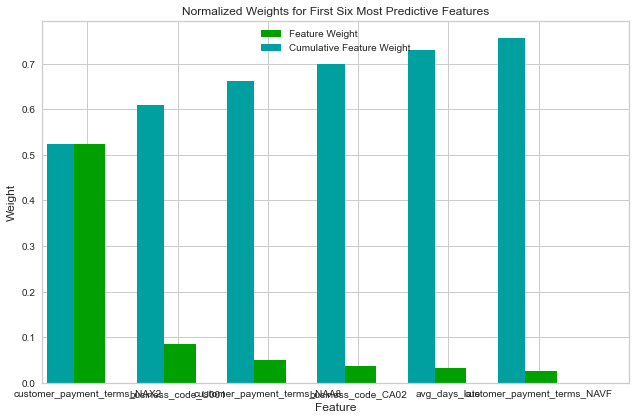

customer_payment_terms_NAX2   : 52.42%
business_code_U001            :  8.58%
customer_payment_terms_NAA8   :  5.11%
business_code_CA02            :  3.71%
avg_days_late                 :  3.18%
customer_payment_terms_NAVF   :  2.63%
customer_payment_terms_NAM3   :  2.09%
business_code_U013            :  1.97%
avg_days_late_outstanding     :  1.58%
customer_payment_terms_NAG2   :  1.56%
ratio_late_paid_inv           :  1.54%
ratio_amount_late_paid        :  1.47%
customer_payment_terms_NAD5   :  1.33%
ratio_late_outstanding_amount :  1.03%
customer_payment_terms_CA10   :  1.02%
total_amount_paid             :  0.98%
paid_inv                      :  0.97%
total_outstanding_amount      :  0.81%
total_open_amount             :  0.68%
late_paid_inv                 :  0.66%
ratio_late_outstanding_inv    :  0.66%
total_outstanding_inv         :  0.61%
customer_payment_terms_NAUX   :  0.58%
customer_payment_terms_CAX2   :  0.57%
business_code_U002            :  0.53%
total_amount_late_paid   

In [84]:
#cloning the best parameters we got by optimization 
xgboost_model = xgboost.XGBRegressor(max_depth= 3, n_estimators = 70).fit(X_train,y_train)
#getting the feature importance by xgboost model 
importances = xgboost_model.feature_importances_
#calling the helper function to plot 6 top predictive features 
feature_plot(importances , X_train , y_train)
#printing the importance of all the features in the form of percentage
feat_xgboost = get_features(xgboost_model)

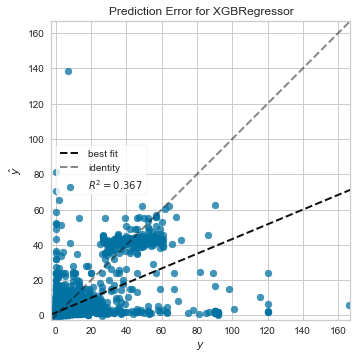

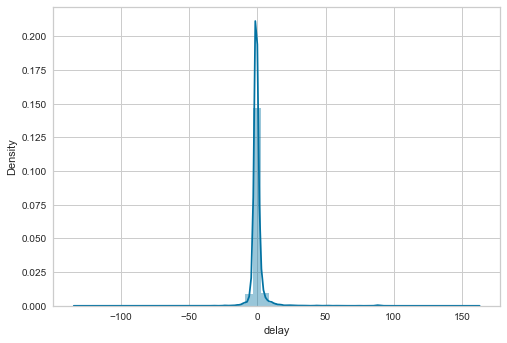

In [85]:
#predicting X_test and storing in preds variable
preds = xgboost_model.predict(X_val)
#getting the prediction error plot
visualizer = prediction_error(xgboost_model , X_train, y_train, X_val, y_val)
#visualizing the distplot to get the error 
ax = sns.distplot(y_val - preds, bins=50)
plt.show()

### Model Selection<a id='task_8'></a>

  - So it's clear that that optimized **Random Forest** outshined other models ***(Linear Regression, SVR - Suport Vector Regressor , KNeighbor Regressor, Gradient Boosting Regressor, Xgboost Regressor)***. So now lets reduced our X train and X test dataset features according to the respective feature importance of the model to calculate predictions on reduced dataset.
  
### Feature Importance
  - So **RandomForest** model assigns weights to each ***independent feature*** based on how much information model can capture regarding the ***dependent feature(delay)***, therefore we will be selecting top 10 independent features for our final model training.

### Predictions on Reduced Features<a id='task_10'></a> 

In [108]:
#reducing the X train and X test to the top 10 features in our dataset
X_train_reduced = X_train[[x[0] for x in sorted(feat_forest.items(), key= lambda x: x[1] , reverse=True) if x[1] > 0.0][:10]] 
X_val_reduced = X_val[[x[0] for x in sorted(feat_forest.items(), key= lambda x: x[1] , reverse=True) if x[1] > 0.0][:10]] 

#fitting our final model with tuned parameters and reduced data
final_model = (clone(best_reg1)).fit(X_train_reduced, y_train)

#predictions on full data
best_predictions = best_reg1.predict(X_val)
#predictions on reduced data
reduced_predictions = final_model.predict(X_val_reduced)

#printing the evaluation metrics of predictions on full and reduced data
print("Final Model trained on full data\n------")
print("R2 Score score on testing data: {:.4f}".format(r2_score(y_val, best_predictions)))
print("RMSE on testing data: {:.4f}".format(np.sqrt(mean_squared_error(y_val, best_predictions))))
print("MAE on testing data: {:.4f}".format(mean_absolute_error(y_val, best_predictions)))
print("\nFinal Model trained on reduced data\n------")
print("R2 Score score on testing data: {:.4f}".format(r2_score(y_val, reduced_predictions)))
print("RMSE on testing data: {:.4f}".format(np.sqrt(mean_squared_error(y_val, reduced_predictions))))
print("MAE on testing data: {:.4f}".format(mean_absolute_error(y_val, reduced_predictions)))

Final Model trained on full data
------
R2 Score score on testing data: 0.3970
RMSE on testing data: 6.6884
MAE on testing data: 2.3904

Final Model trained on reduced data
------
R2 Score score on testing data: 0.3904
RMSE on testing data: 6.7249
MAE on testing data: 2.4244


In [87]:
X_train_reduced.head()

,customer_payment_terms_NAX2,avg_days_late,business_code_U001,customer_payment_terms_NAVF,total_open_amount,avg_days_late_outstanding,customer_payment_terms_NAG2,paid_inv,customer_payment_terms_NAD5,total_amount_late_paid
17471,0.0,0.014115,1.0,0.0,0.100953,0.0,0.0,0.002901,0.0,0.040923
17503,0.0,0.006645,1.0,0.0,0.000177,0.0,0.0,0.048356,0.0,0.015599
43904,0.0,0.007166,1.0,0.0,0.007493,0.0,0.0,0.081238,0.0,0.050083
10722,0.0,0.006949,1.0,0.0,0.088665,0.5,0.0,0.162476,0.0,0.162059
31048,0.0,0.009630,1.0,0.0,0.069787,0.0,0.0,0.031915,0.0,0.219647


#### Saving the model
   -  So RandomForest is the best model according to our analysis on the dataset. Therefore i will save the model using pickle for further use in predictions.

In [88]:
#saving the model to local disk for production use in future
import pickle
pickle.dump(final_model, open('final_forest.pkl', 'wb'))

### Processing and Feature Engineering Test Dataset
  - I have engineered only top 10 features of the train data in the test data according to the **RandomForest** model.

In [89]:
test.head()

,business_code,customer_number,customer_name,clear_date,business_year,document_id,posting_date,document_create_date,invoice_doc_create_date,due_date,invoice_currency,total_open_amount,baseline_create_date,customer_payment_terms,invoice_id
46334,U001,0200794332,COST associates,NaT,2020.0,1.930703e+09,2020-03-25,2020-03-25,2020-03-25,2020-04-09,USD,11722.55,2020-03-25,NAAX,1.930703e+09
46335,U001,0200771157,WEIS llc,NaT,2020.0,1.930624e+09,2020-03-09,2020-03-09,2020-03-09,2020-03-24,USD,125822.66,2020-03-09,NAA8,1.930624e+09
46336,U001,0200711029,WEGMAN co,NaT,2020.0,1.930687e+09,2020-03-22,2020-03-23,2020-03-22,2020-04-06,USD,30968.80,2020-03-22,NAA8,1.930687e+09
46337,U001,0200769623,WAL-MAR corporation,NaT,2020.0,1.930704e+09,2020-03-26,2020-03-25,2020-03-26,2020-04-10,USD,1329.23,2020-03-26,NAH4,1.930704e+09
46338,U001,0200704858,WAKE us,NaT,2020.0,1.930672e+09,2020-03-20,2020-03-19,2020-03-20,2020-04-04,USD,72410.05,2020-03-20,NAA8,1.930672e+09


In [90]:
#sorting the dataset wrt invoice document create date to engineer features correctly
test = test.sort_values(by = 'invoice_doc_create_date')
#reseting index and droping the default index column
test = test.reset_index(drop=True)

#converting date columns test and df to datetime format
test.invoice_doc_create_date = test.invoice_doc_create_date.apply(lambda x: pd.to_datetime(x))
test.due_date = test.due_date.apply(lambda x: pd.to_datetime(x))
df.invoice_doc_create_date = df.invoice_doc_create_date.apply(lambda x: pd.to_datetime(x))
df.clear_date = df.clear_date.apply(lambda x: pd.to_datetime(x))
df.due_date = df.due_date.apply(lambda x: pd.to_datetime(x))

In [91]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3666 entries, 0 to 3665
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   business_code            3666 non-null   object        
 1   customer_number          3666 non-null   object        
 2   customer_name            3666 non-null   object        
 3   clear_date               0 non-null      datetime64[ns]
 4   business_year            3666 non-null   float64       
 5   document_id              3666 non-null   float64       
 6   posting_date             3666 non-null   datetime64[ns]
 7   document_create_date     3666 non-null   datetime64[ns]
 8   invoice_doc_create_date  3666 non-null   datetime64[ns]
 9   due_date                 3666 non-null   datetime64[ns]
 10  invoice_currency         3666 non-null   object        
 11  total_open_amount        3666 non-null   float64       
 12  baseline_create_date     3666 non-

Again initializing some functions to engineer only top 10 features according to random forest model

In [92]:
#function to get the Average days late of all paid invoices that were late 
#prior to the creation date of a new invoice for a customer.
def days_late(name,date):
    #filtering late paid invoices wrt a particular customer whose clear date is less than the 
    #creation date of new invoice and returning the mean of total days delayed
    return df.query('customer_name == @name and clear_date < @date and delay > 0').delay.mean()

#function to get the Average days late of all the late outstanding invoices  
#prior to the creation date of a new invoice for a customer.
def days_late_outstanding(name,date):
    #filtering late outstanding invoices wrt a particular customer whose clear date is less than the 
    #creation date of new invoice and returning the mean of total days delayed
    return df.query('customer_name == @name and invoice_doc_create_date < @date and due_date < @date and clear_date > @date').delay.mean()


def paid(name,date):
    #filtering paid invoices wrt a particular customer whose clear date is less than the creation date of new invoice
    return int(df.query('customer_name == @name and clear_date < @date').customer_name.count())

#function to get the sum of the base amount from all the paid invoices prior to the creation 
#of new invoice for a customer.
def amount_paid(name,date):
    #filtering sum of amount of the paid invoices wrt a particular customer whose clear date is less than
    #the creation date of new invoice
    return int(df.query('customer_name == @name and clear_date < @date').total_open_amount.sum())

#function to get the The sum of the base amount from all the paid invoices which were 
#late prior to the creation of new invoice for a customer.
def amount_late_paid(name,date):
    #filtering sum of amount of the late paid invoices wrt a particular customer whose clear date 
    #is less than the creation date of new invoice
    return int(df.query('customer_name == @name and clear_date < @date and delay > 0').total_open_amount.sum())

In [93]:
#creating a new column to store the mean of total days delayed
test['avg_days_late'] = None
#creating a new column to store the mean of total days delayed
test['avg_days_late_outstanding'] = None
#creating a new column to store the paid invoices of a particuar customer              
test['paid_inv'] = None
#creating a new column to store the sum of amount of the paid invoices of a particular customer
test['total_amount_paid'] = None
#creating a new column to store the sum of amount of the late paid invoices of a particular customer
test['total_amount_late_paid'] = None

#initializing a for loop to pass the name and date of the creation of a new invoice to the specified functions
for i,v in enumerate(test.customer_name):
    test['avg_days_late'].loc[i] = days_late(v,test.invoice_doc_create_date.loc[i])


#initializing a for loop to pass the name and date of the creation of a new invoice to the specified functions
for i,v in enumerate(test.customer_name):
    test['avg_days_late_outstanding'].loc[i] = days_late_outstanding(v,test.invoice_doc_create_date.loc[i])


#initializing a for loop to pass the name and date of the creation of a new invoice to the specified functions
for i,v in enumerate(test.customer_name):
    test.paid_inv.loc[i] = paid(v,test.invoice_doc_create_date.loc[i])


#initializing a for loop to pass the name and date of the creation of a new invoice to the specified functions
for i,v in enumerate(test.customer_name):
    test['total_amount_paid'].loc[i] = amount_paid(v,test.invoice_doc_create_date.loc[i])
    test['total_amount_late_paid'].loc[i] = amount_late_paid(v,test.invoice_doc_create_date.loc[i])

    
#convering the datatype of the columns to integer
test.avg_days_late = pd.to_numeric(test.avg_days_late)

#convering the datatype of the columns to integer
test['avg_days_late_outstanding'] = pd.to_numeric(test['avg_days_late_outstanding'])

#convering the datatype of the columns to integer
test.paid_inv = pd.to_numeric(test.paid_inv)

#convering the datatype of the columns to integer
test.total_amount_paid = pd.to_numeric(test.total_amount_paid)
test.total_amount_late_paid = pd.to_numeric(test.total_amount_late_paid)

### Normalizing the numerical columns of test data

In [94]:
#import MinMaxScaler from sklearn to normalize the numerical features
from sklearn.preprocessing import MinMaxScaler

#initializing the scaler function 
scaler = MinMaxScaler()
#storing the independent feature to a variable x 

cols = ['avg_days_late', 'total_open_amount', 'avg_days_late_outstanding',
        'paid_inv','total_amount_paid','total_amount_late_paid']
test[cols] = scaler.fit_transform(test[cols])

In [95]:
#one hot encoding catagorical features to elevate model's performance
cols = ['business_code', 'customer_payment_terms']

test = pd.get_dummies(test ,columns = cols)

In [96]:
test.shape

(3666, 61)

In [97]:
test.head()

,customer_number,customer_name,clear_date,business_year,document_id,posting_date,document_create_date,invoice_doc_create_date,due_date,invoice_currency,...,customer_payment_terms_NAU5,customer_payment_terms_NAUP,customer_payment_terms_NAV9,customer_payment_terms_NAVC,customer_payment_terms_NAVE,customer_payment_terms_NAVF,customer_payment_terms_NAVM,customer_payment_terms_NAVQ,customer_payment_terms_NAWP,customer_payment_terms_NAX2
0,0200769623,WAL-MAR systems,NaT,2020.0,1.930579e+09,2020-02-27,2020-02-27,2020-02-27,2020-03-13,USD,...,0,0,0,0,0,0,0,0,0,0
1,0200705742,DOT corp,NaT,2020.0,1.930576e+09,2020-02-27,2020-02-26,2020-02-27,2020-03-18,USD,...,0,0,0,0,0,0,0,0,0,0
2,0200769623,WAL-MAR co,NaT,2020.0,1.930571e+09,2020-02-27,2020-02-26,2020-02-27,2020-03-13,USD,...,0,0,0,0,0,0,0,0,0,0
3,0200418007,AM llc,NaT,2020.0,1.930561e+09,2020-02-27,2020-02-24,2020-02-27,2020-03-13,USD,...,0,0,0,0,0,0,0,0,0,0
4,0200762301,C&S WH corporation,NaT,2020.0,1.930568e+09,2020-02-27,2020-02-25,2020-02-27,2020-03-13,USD,...,0,0,0,0,0,0,0,0,0,0


In [98]:
#replacing all null values with 0
test.fillna(0 , inplace = True)

### Loading the Model

In [99]:
#loading the trained model for prediction
import pickle
model = pickle.load(open('final_forest.pkl', 'rb'))

### Inference On Test Dataset<a id='task_11'></a>

In [100]:
#intitializing a new dataframe with basic customer details
cols = ['customer_name' ,'invoice_doc_create_date', 'due_date', 'predicted_delay' ]

#saving all the pre-requisite values from test dataset
predict = pd.DataFrame(columns = cols)
predict['customer_name'] = test['customer_name']
predict['invoice_doc_create_date'] = test['invoice_doc_create_date']
predict['due_date'] = test['due_date']

#our predicted value will be stored in this column, therefore initializing with none
predict['predicted_delay'] = None

#initializing a for loop to pass the location and values of each respective customer for prediction
for i,v in enumerate(test.customer_name):
    x = [test.customer_payment_terms_NAX2[i] , test.avg_days_late[i], test.business_code_U001[i],
         test.customer_payment_terms_NAVF[i], test.total_open_amount[i], test.avg_days_late_outstanding[i],
        test.customer_payment_terms_NAG2[i], test.paid_inv[i] , test.customer_payment_terms_NAD5[i],
        test.total_amount_late_paid[i]]
    #predicting 
    predict['predicted_delay'].loc[i] = int(model.predict([x]))

In [101]:
#fucntion to get the predicted date i.e due_date + predicted_delay
from datetime import timedelta
def get_date(date, delay):
    return date + timedelta(days = delay)


def bucket(delay):
    if delay >= 0 and delay <= 15:
        x = '0-15 Days'
        return x
    elif delay > 15 and delay <=30:
        x= '16-30 Days'
        return x
    elif delay >30 and delay <=45:
        x = '30-45 Days'
        return x
    elif delay > 45 and delay <=60:
        x = '45-60 Days'
        return x
    else:
        x = 'Greater than 60 Days'
        return x
    
#curating new columns for reflecting predicted date and bucket of each customer
predict['predicted_date'] = None
predict['bucket'] = None

#initializing for loop to store values in new columns by passing values to the function
for i,v in enumerate(predict.customer_name):
    predict['predicted_date'].loc[i] = get_date(predict.due_date[i], predict.predicted_delay[i])
    predict['bucket'].loc[i] = bucket(predict.predicted_delay[i])

### Final Result<a id='task_12'></a>

In [102]:
#displaying the final result
predict.predicted_date = predict.predicted_date.apply(lambda x: pd.to_datetime(x))
predict.head(40)

,customer_name,invoice_doc_create_date,due_date,predicted_delay,predicted_date,bucket
0,WAL-MAR systems,2020-02-27,2020-03-13,1,2020-03-14,0-15 Days
1,DOT corp,2020-02-27,2020-03-18,1,2020-03-19,0-15 Days
2,WAL-MAR co,2020-02-27,2020-03-13,1,2020-03-14,0-15 Days
3,AM llc,2020-02-27,2020-03-13,1,2020-03-14,0-15 Days
4,C&S WH corporation,2020-02-27,2020-03-13,1,2020-03-14,0-15 Days
5,W LEE foundation,2020-02-27,2020-03-13,2,2020-03-15,0-15 Days
6,KWI us,2020-02-27,2020-03-13,1,2020-03-14,0-15 Days
7,RALEY in,2020-02-27,2020-03-13,4,2020-03-17,0-15 Days
8,DOT in,2020-02-27,2020-03-13,1,2020-03-14,0-15 Days
9,RESTA,2020-02-27,2020-03-13,1,2020-03-14,0-15 Days
